In [1]:
#from sqlite3 import SQLITE_CREATE_VIEW
import anndata
import scanpy as sc
import os
#from bbknn import bbknn
import matplotlib.pyplot as plt
#import omicverse as ov
#import scib
#from scib_metrics.benchmark import Benchmarker
#import scvi
#import scanorama
import numpy as np
#import pyliger
#from harmony import harmonize
#from rich import print
#import seaborn as sns
#import bbknn
#import doubletdetection
#%matplotlib inline
import pandas as pd
#plt.rcParams.update({'font.size': 12})

In [2]:
plt.rcParams['pdf.fonttype'] = 42  # Ensures that fonts are saved as text, not outlines
plt.rcParams['font.sans-serif'] = ['Arial']  # Use Arial or another common font
# Change the font to 'DejaVu Sans' or another available font
plt.rcParams['font.sans-serif'] = ['DejaVu Sans']
plt.rcParams['font.family'] = 'sans-serif'

In [3]:
#####Change path and Load data
os.chdir("/storage/liuxiaodongLab/fanxueying/mayanalysis/2024Aug")
adata = anndata.read_h5ad("human_monkey_clustering.h5ad")

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


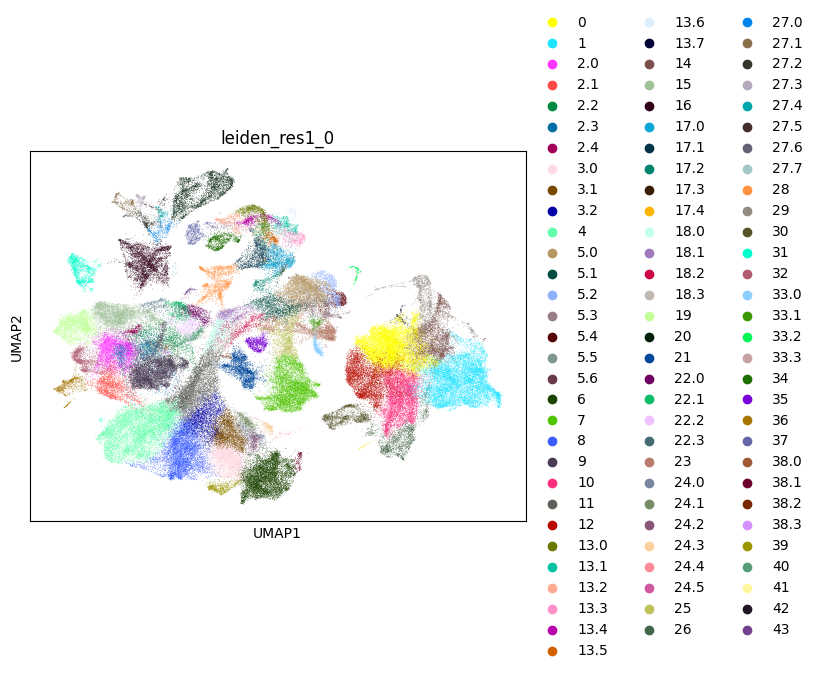

In [4]:
# plot
sc.pl.umap(adata, color=['leiden_res1_0'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


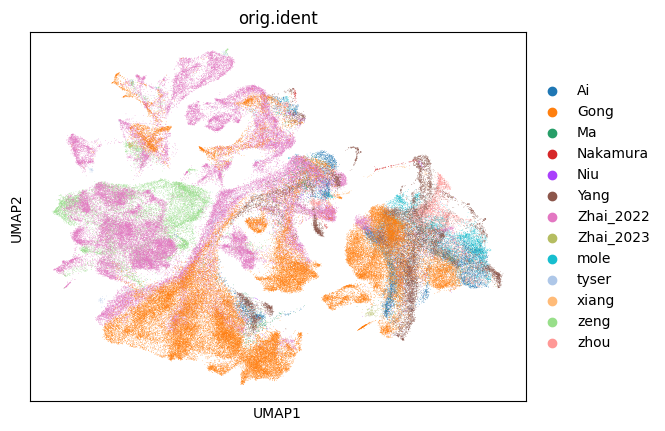

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


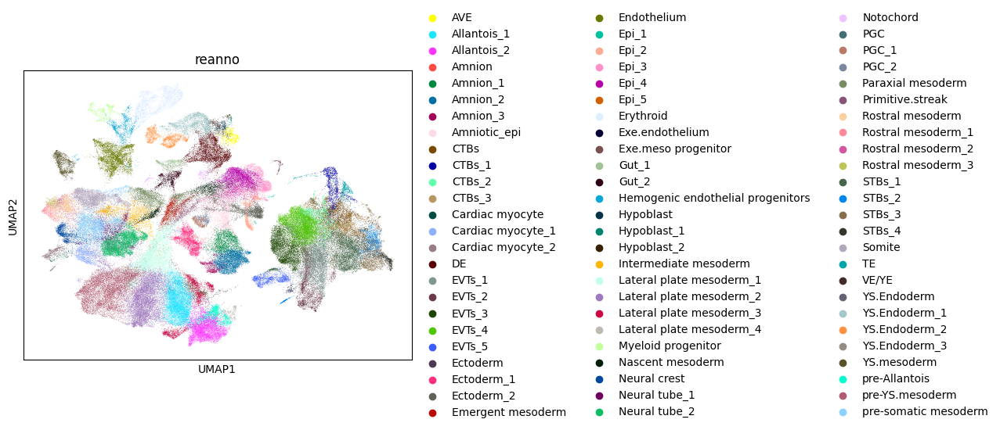

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


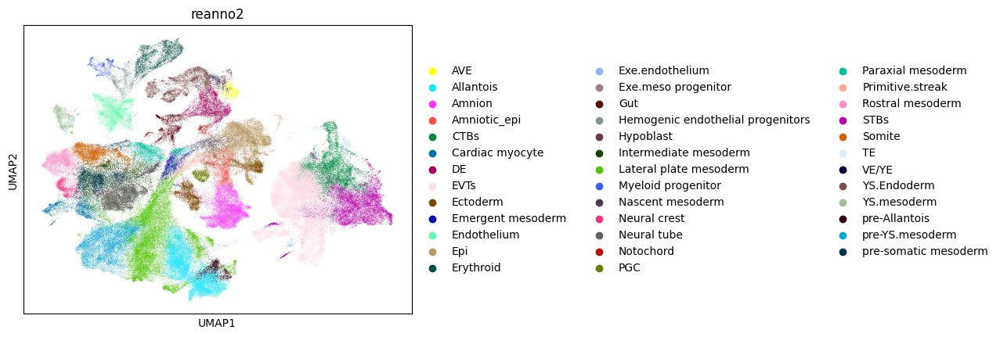

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


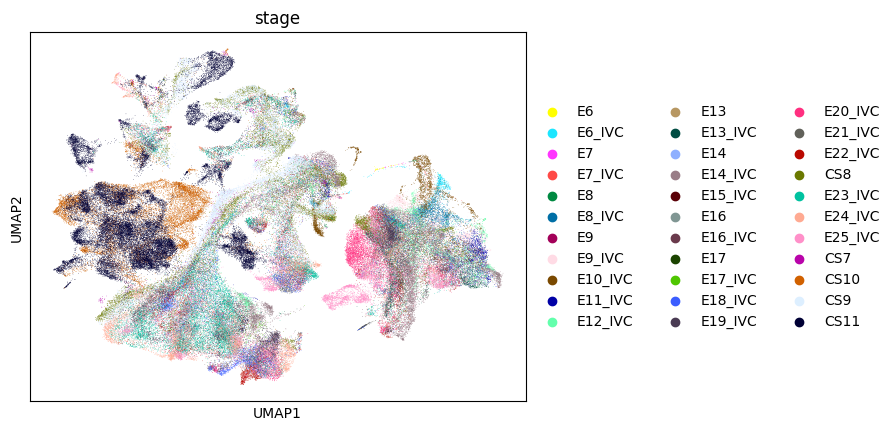

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


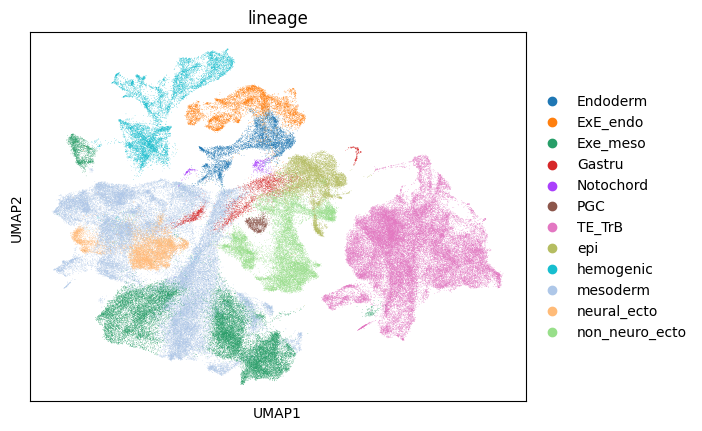

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


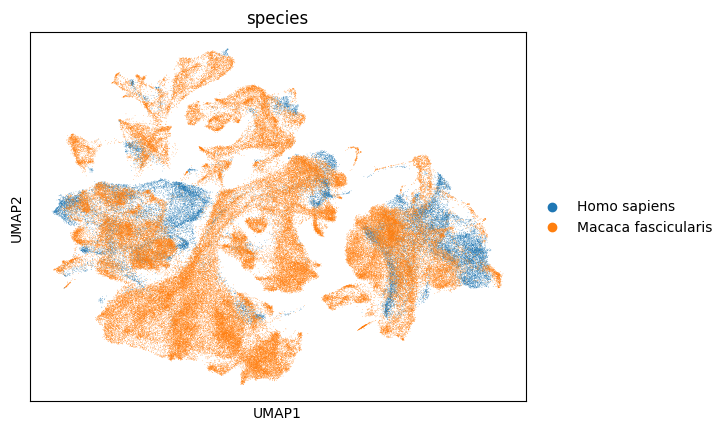

In [5]:
adata.obsm['X_umap']=adata.obsm['X_scANVI']
sc.pl.umap(adata, color=['orig.ident'])
sc.pl.umap(adata, color=['reanno'])
sc.pl.umap(adata, color=['reanno2'])
sc.pl.umap(adata, color=['stage'])
sc.pl.umap(adata, color=['lineage'])
sc.pl.umap(adata, color=['species'])

In [6]:
#dot plot
TE_marker_genes = {
    "general": [ "GATA3","TFAP2A","TFAP2C",],
    "TE": [ "TEAD4", "POU5F1","CDX2",],
    "CTBs": [ "ITGA6","FABP5","FGFR1","PEG10","CDH1", ],
    "early_STBs": ["ESRRG","MAFK","TBX20","ATF3",], #"ZNF292",
    "STBs": ["TBX3","CGB2","CGB7","PSG3","PSG6",],
   # "early_EVTs": ["DLX6","HIF1A","NR1H3","DLX5","TFDP2","RXRA",],
    "EVTs":["HLA-G","CSH1","MMP2","ERBB2","KRT7","ASCL2", "SP100", "IRF9", "SP110", "STAT6", "ZNF462",]
   
}


/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


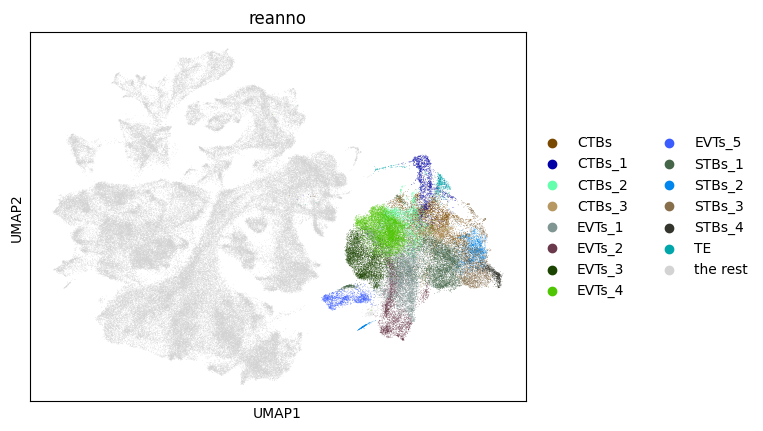

In [7]:
# Plot UMAP with specified colors and groups
ax = sc.pl.umap(adata, color=["reanno"], groups=['TE', 'CTBs', 'STBs_1', 'STBs_2', 'STBs_3', 'EVTs_1', 'EVTs_2',
                  'TE', 'CTBs_1', 'CTBs_2', 'CTBs_3', 'STBs_1', 'STBs_2', 'STBs_3', 'STBs_4', 'STBs_5',
                  'EVTs_1', 'EVTs_2', 'EVTs_3', 'EVTs_4', 'EVTs_5',], show=False)

# Change legend text from "NA" to "the rest"
legend_texts = ax.get_legend().get_texts()
for legend_text in legend_texts:
    if legend_text.get_text() == "NA":
        legend_text.set_text("the rest")


In [8]:
# focusing on TE/TrB lineage
ana_sub= adata[adata.obs['reanno'].isin(['TE', 'CTBs','CTBs_1', 'CTBs_2', 'CTBs_3',
                                         'EVTs_1', 'EVTs_2', 'EVTs_3', 'EVTs_4', 'EVTs_5',
                                         'STBs_1', 'STBs_2', 'STBs_3','STBs_4',
                  ])]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


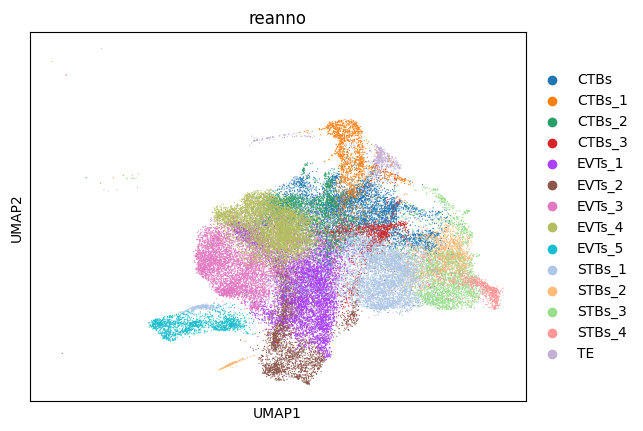

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


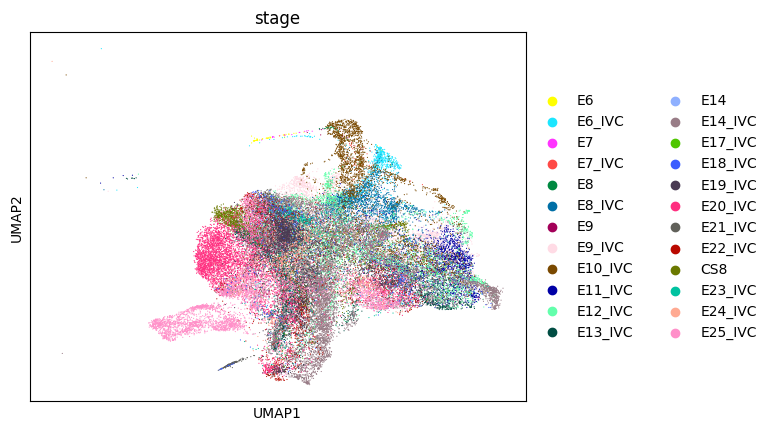

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


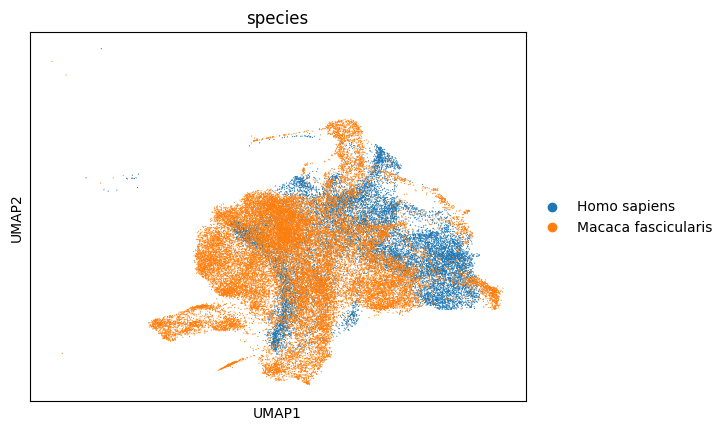

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


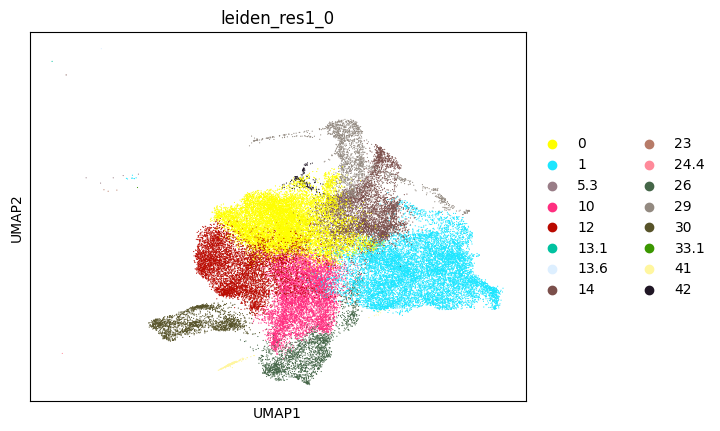

In [9]:
sc.pl.umap(ana_sub, color=['reanno'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['species'])
sc.pl.umap(ana_sub, color=['leiden_res1_0'])

In [10]:
# Use value_counts to count the number of cells in each cluster
cluster_counts = ana_sub.obs['leiden_res1_0'].value_counts()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Print the counts
print(cluster_counts)


0       11437
1       10521
10       6680
12       5471
14       4524
26       2102
29       1925
30       1779
41        203
42        185
5.3         5
23          3
13.1        1
13.6        1
24.4        1
33.1        1
Name: leiden_res1_0, dtype: int64


In [11]:
# Subset the clusters that have more than 10 counts
clusters_to_keep = cluster_counts[cluster_counts > 200].index

# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_res1_0'].isin(clusters_to_keep)]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


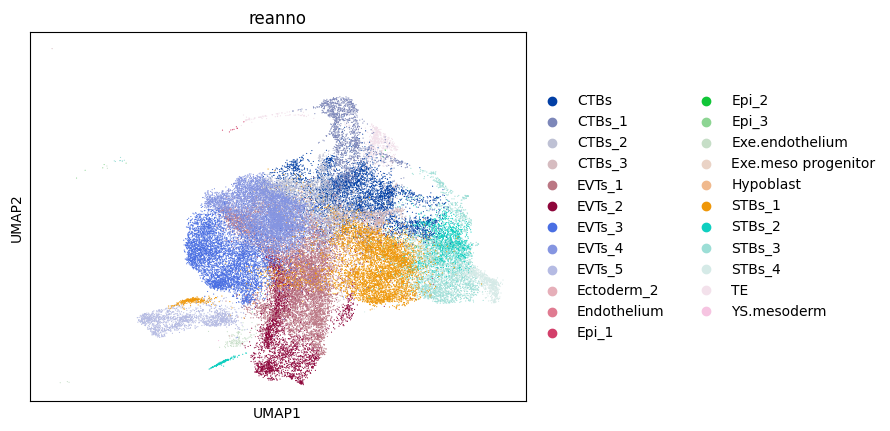

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


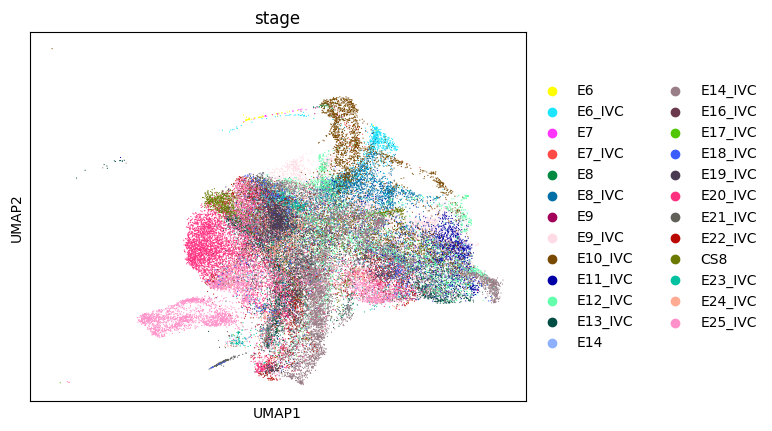

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


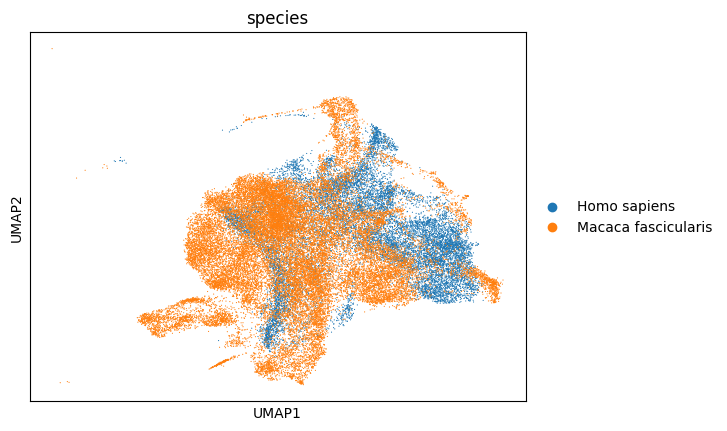

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


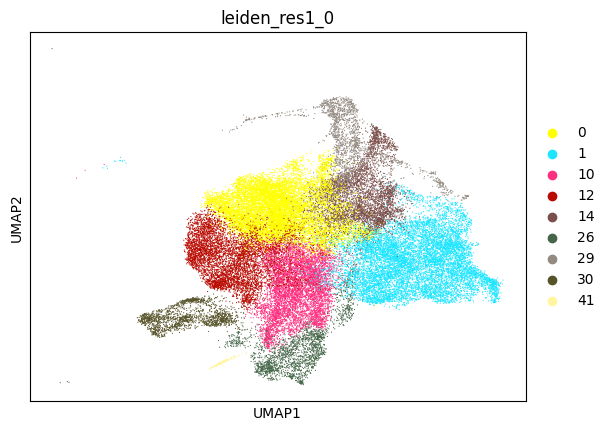

In [12]:
sc.pl.umap(ana_sub, color=['reanno'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['species'])
sc.pl.umap(ana_sub, color=['leiden_res1_0'])

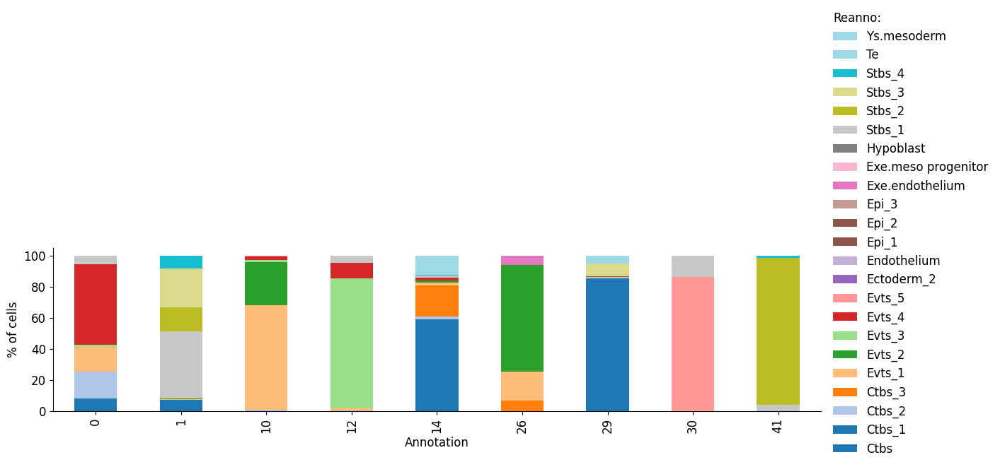

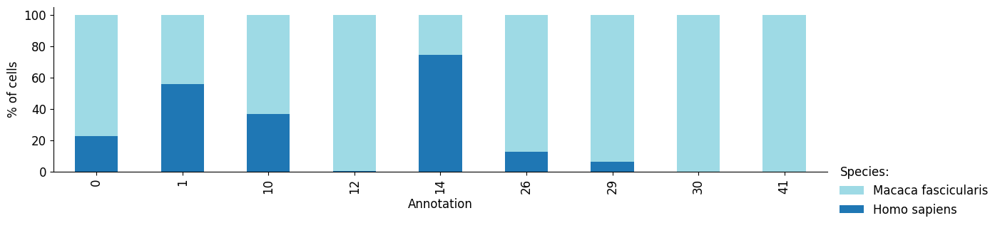

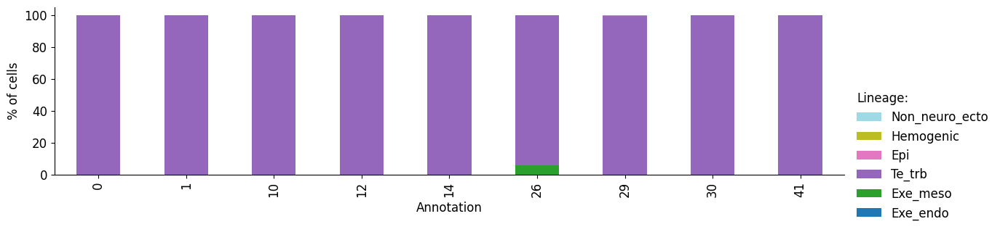

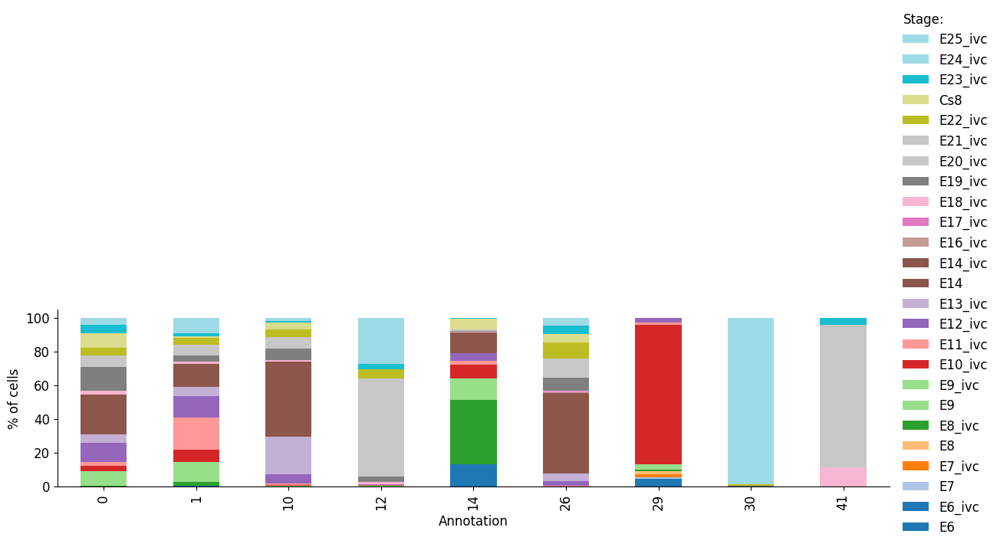

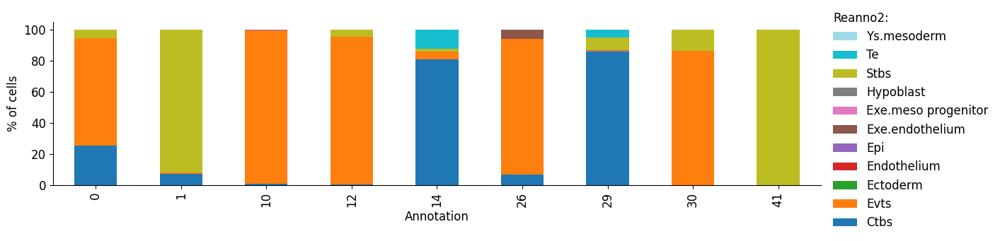

In [13]:
FIGURES = dict()
fz = 12
annos = ['reanno', 'species', 'lineage','stage','reanno2']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['leiden_res1_0'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


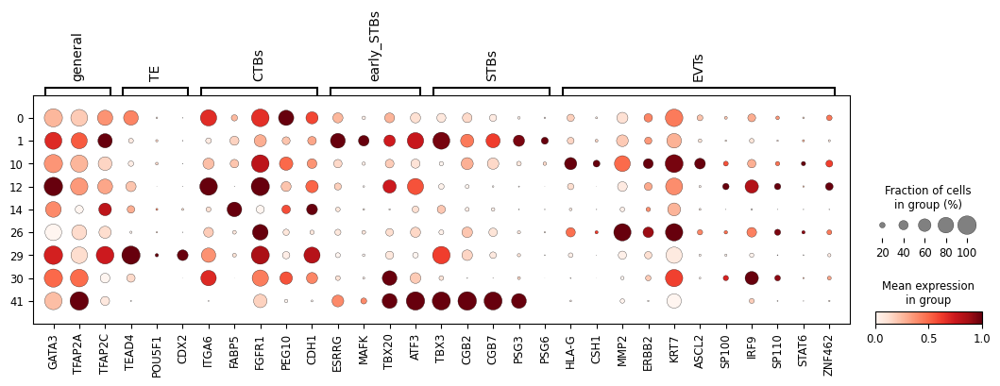

In [14]:
sc.pl.dotplot(ana_sub, TE_marker_genes, groupby="leiden_res1_0", use_raw=False, standard_scale="var")

In [15]:
##rename clusters

ana_sub.obs['reanno_3'] = ana_sub.obs['leiden_res1_0'].cat.add_categories(['CTBs_1','CTBs_2','CTBs_3','STBs_1','STBs_2',
                                                                           'EVTs_1','EVTs_2','EVTs_3','EVTs_4',
                      ])

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '29' ])] = 'CTBs_1'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '14' ])] = 'CTBs_2'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '0' ])] = 'CTBs_3'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '1' ])] = 'STBs_1'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '41' ])] = 'STBs_2'


ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '10' ])] = 'EVTs_1'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '26' ])] = 'EVTs_2'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '30' ])] = 'EVTs_3'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '12' ])] = 'EVTs_4'


ana_sub.obs['reanno_3'] = ana_sub.obs['reanno_3'].cat.remove_unused_categories()

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


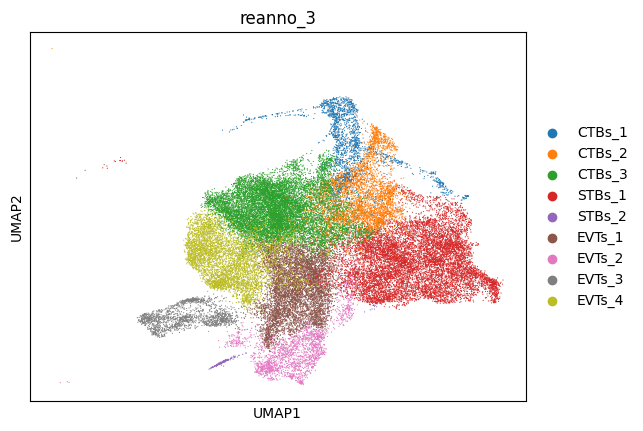

In [16]:
sc.pl.umap(ana_sub, color=['reanno_3'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


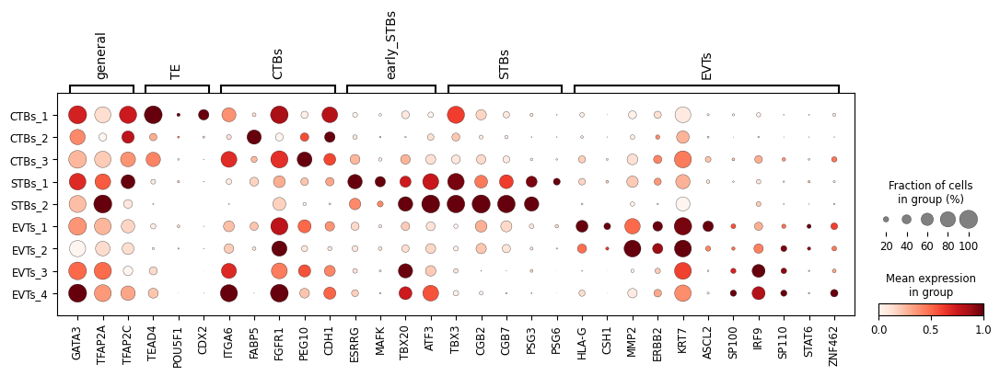

In [17]:
sc.pl.dotplot(ana_sub, TE_marker_genes, groupby="reanno_3", use_raw=False, standard_scale="var")

In [18]:
# Step 1: Annotate the cells in cluster_A_cells based on their sub-cluster labels
# The sub-cluster labels are stored in the 'sub_cluster' column of cluster_A_cells.obs
sub_cluster_labels = ana_sub.obs['reanno_3']

# Step 2: Add these annotations back to the main AnnData object
# Create a new column in the main AnnData object to store the sub-cluster labels for cluster A cells
adata.obs['reanno_3'] = 'NA'

# Update the main AnnData object with the sub-cluster labels for the cells in cluster A
adata.obs.loc[ana_sub.obs.index, 'reanno_3'] = sub_cluster_labels

# Optionally, verify the changes
print(adata.obs['reanno_3'].value_counts())

NA        130465
CTBs_3     11440
STBs_1     10530
EVTs_1      6693
EVTs_4      5472
CTBs_2      4526
EVTs_2      2232
CTBs_1      1934
EVTs_3      1779
STBs_2       203
Name: reanno_3, dtype: int64


/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


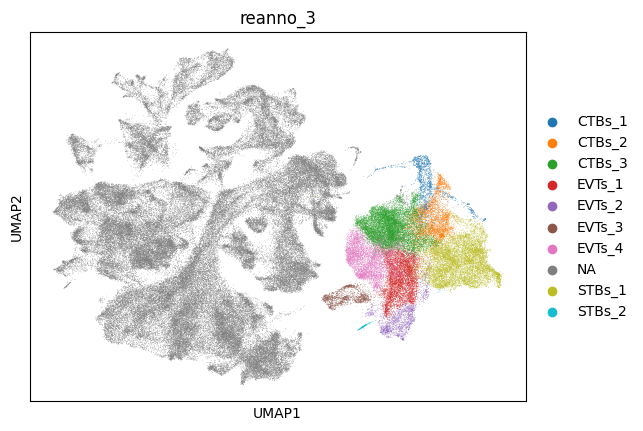

In [19]:
sc.pl.umap(adata, color=['reanno_3'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


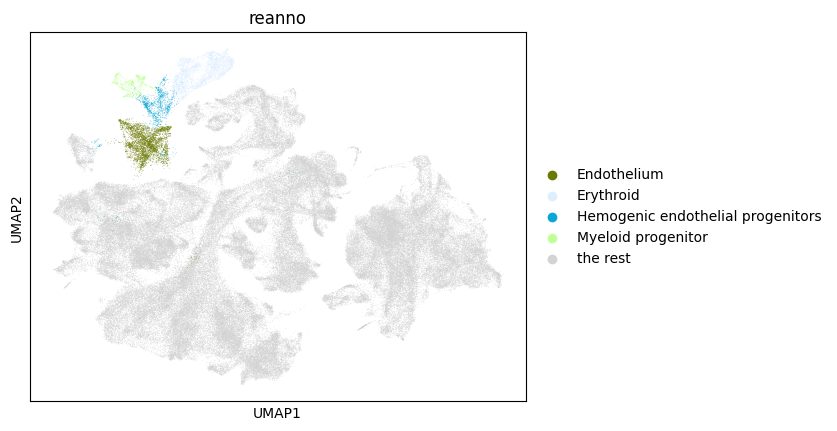

In [20]:
# Plot UMAP with specified colors and groups
ax = sc.pl.umap(adata, color=["reanno"], groups=[ 'Hemogenic endothelial progenitors',
       'Hemogenic endothelial progenitor', 'Endothelium', 'Erythroid',
       'Myeloid progenitor',], show=False)

# Change legend text from "NA" to "the rest"
legend_texts = ax.get_legend().get_texts()
for legend_text in legend_texts:
    if legend_text.get_text() == "NA":
        legend_text.set_text("the rest")


In [21]:
# focusing on blood lineage
ana_sub= adata[adata.obs['reanno'].isin([ 'Hemogenic endothelial progenitors',
        'Endothelium', 'Erythroid',
       'Myeloid progenitor' ])] 

In [22]:
# Use value_counts to count the number of cells in each cluster
cluster_counts = ana_sub.obs['leiden_res1_0'].value_counts()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Print the counts
print(cluster_counts)


16      4313
20      3358
27.0     500
27.1     486
27.2     443
27.3     232
27.4     214
27.5     156
27.6      66
31        50
11        30
27.7      20
5.0       11
2.0        6
25         5
18.0       4
17.0       3
4          3
21         2
19         2
18.2       2
18.1       2
7          2
22.0       1
22.3       1
2.4        1
13.3       1
12         1
6          1
5.1        1
3.1        1
3.0        1
34         1
40         1
Name: leiden_res1_0, dtype: int64


In [23]:
# Subset the clusters that have more than 10 counts
clusters_to_keep = cluster_counts[cluster_counts > 50].index

# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_res1_0'].isin(clusters_to_keep)]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


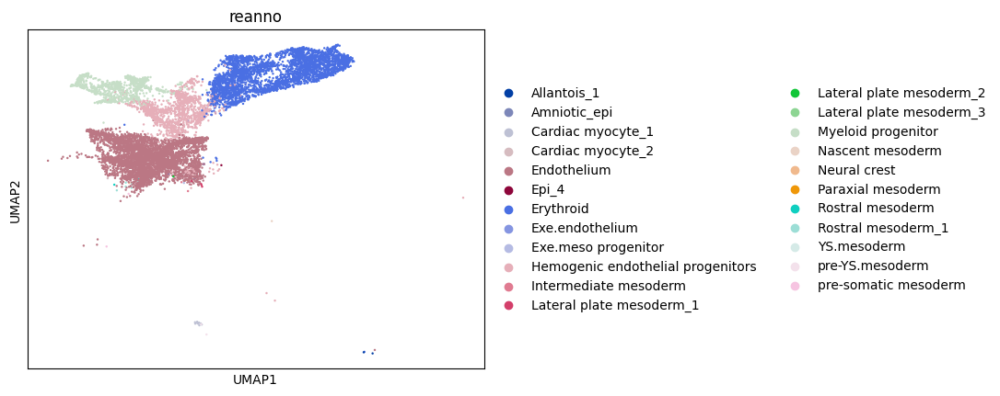

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


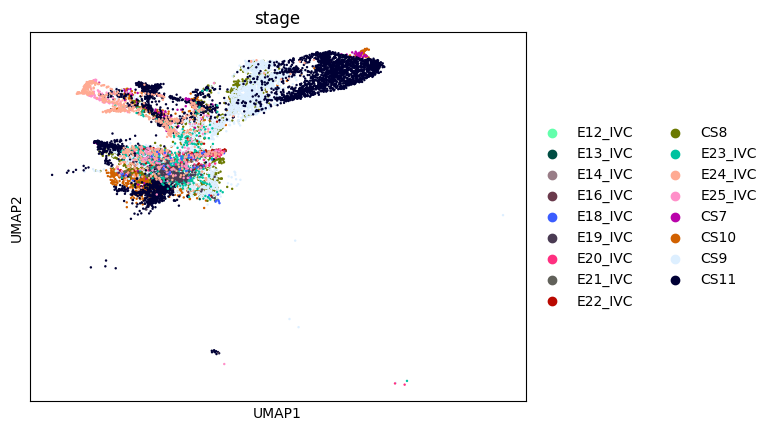

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


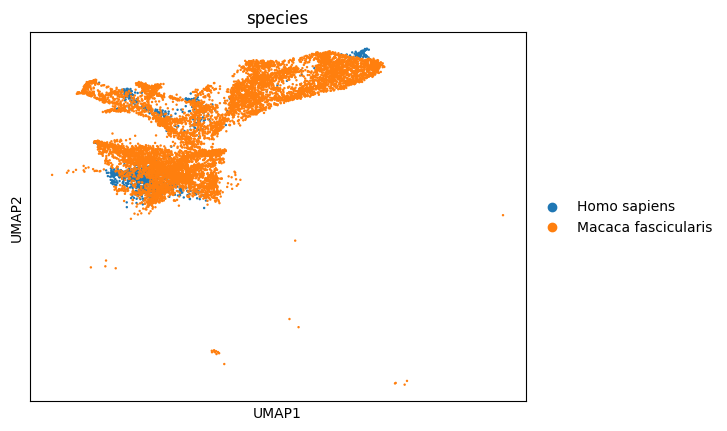

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


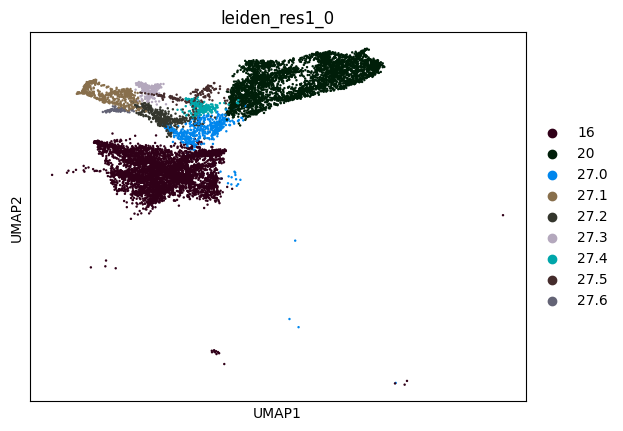

In [24]:
sc.pl.umap(ana_sub, color=['reanno'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['species'])
sc.pl.umap(ana_sub, color=['leiden_res1_0'])

In [25]:
#dot plot
hemato_marker_genes = {
     "Primitive.streak": ["TBXT", "SP5", "HOXA1", "CDX1", "CDX2","MIXL1", "FST" ],
    "endothelial": [ "PECAM1","CDH5", "KDR", "TEK"],
    "erythroblasts":["HBZ", "HBE1", "GATA1", ],
    "erythroid": [ "GATA1", "KLF1", "GYPB", "HBE1"],
    "megakatyocyte":["GP1BB", "ITGA2B", "NFE2", ],
    "myeloid progenitor": [ "PTPRC", "CSF1R", "LYVE1",],  
   
}

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


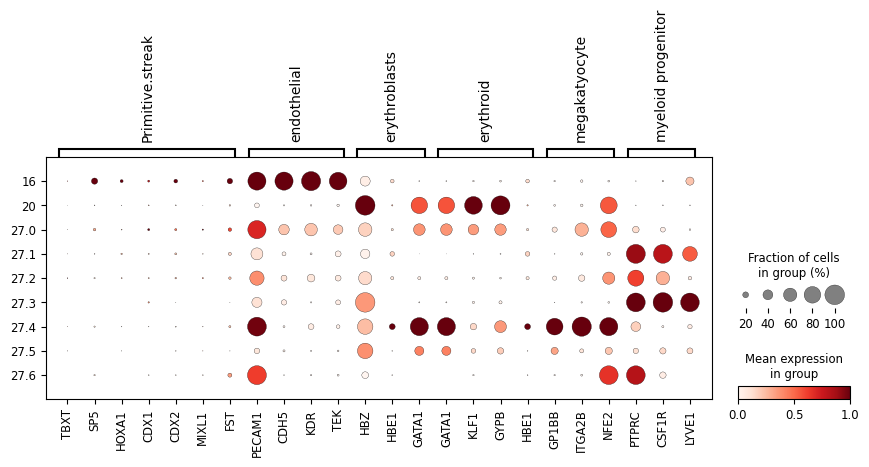

In [26]:
sc.pl.dotplot(ana_sub, hemato_marker_genes, groupby="leiden_res1_0", use_raw=False, standard_scale="var")

In [27]:
##rename clusters

ana_sub.obs['reanno_3'] = ana_sub.obs['leiden_res1_0'].cat.add_categories(['Endothelium', 'Myeloid progenitor', 'Erythroid','Hemogenic endothelial progenitors',
                      ])

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '16' ])] = 'Endothelium'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '20' ])] = 'Erythroid'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '27.1','27.3' ])] = 'Myeloid progenitor'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], ['27.0','27.2','27.4','27.5','27.6' ])] = 'Hemogenic endothelial progenitors'


ana_sub.obs['reanno_3'] = ana_sub.obs['reanno_3'].cat.remove_unused_categories()

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


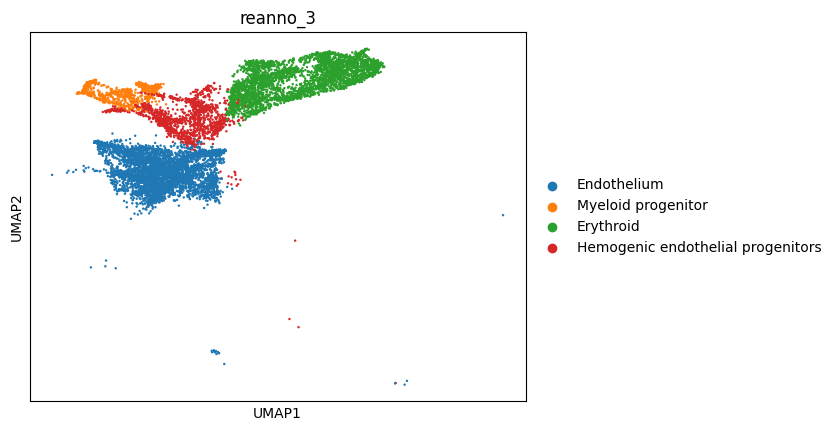

In [28]:
sc.pl.umap(ana_sub, color=['reanno_3'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


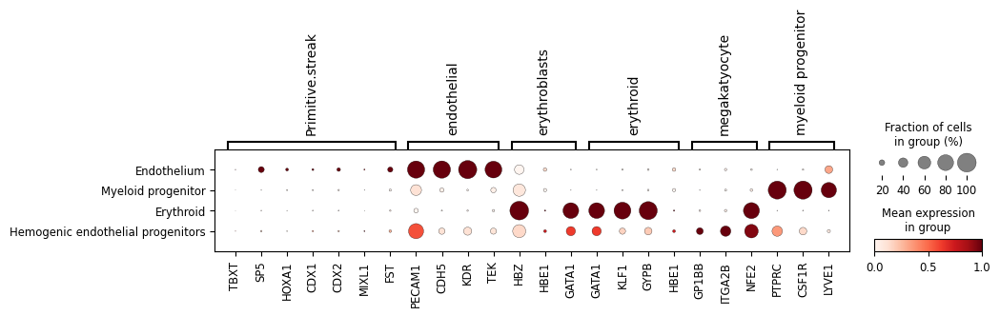

In [29]:
sc.pl.dotplot(ana_sub, hemato_marker_genes, groupby="reanno_3", use_raw=False, standard_scale="var")

In [30]:
# Extract the sub-cluster labels
sub_cluster_labels = ana_sub.obs['reanno_3']

# Combine the categories
combined_categories = pd.CategoricalDtype(categories=list(set(adata.obs['reanno_3'].cat.categories).union(set(sub_cluster_labels.cat.categories))))

# Convert both columns to the combined categories
adata.obs['reanno_3'] = adata.obs['reanno_3'].astype(combined_categories)
sub_cluster_labels = sub_cluster_labels.astype(combined_categories)

# Ensure indices in ann_sub are a subset of those in adata
assert set(ana_sub.obs.index).issubset(set(adata.obs.index)), "Indices in ann_sub are not a subset of those in adata"

# Update 'reanno' in adata with the values from sub_cluster_labels
adata.obs.loc[ana_sub.obs.index, 'reanno_3'] = sub_cluster_labels.loc[ana_sub.obs.index]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


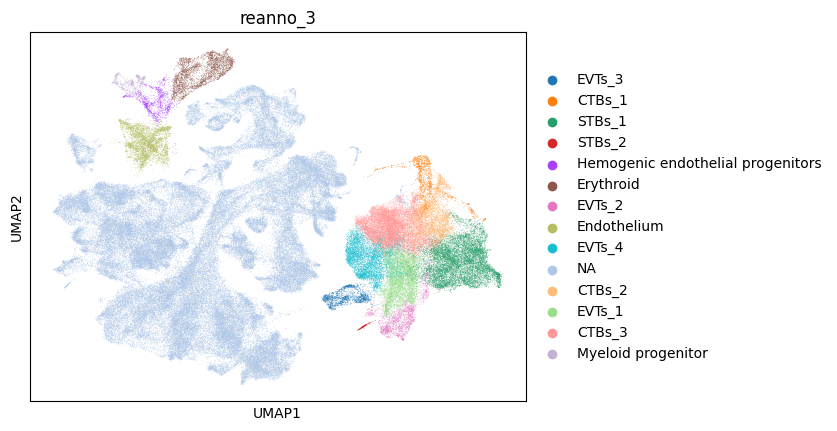

In [31]:
sc.pl.umap(adata, color=['reanno_3'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


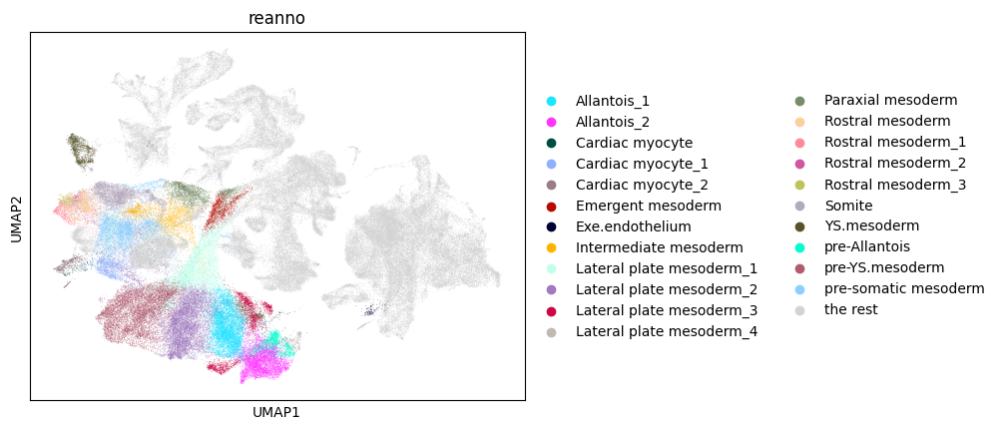

In [32]:
# Plot UMAP with specified colors and groups
ax = sc.pl.umap(adata, color=["reanno"], groups=[   'Paraxial mesoderm','Intermediate mesoderm','Emergent mesoderm',
                  'Lateral plate mesoderm_1','Lateral plate mesoderm_2','Lateral plate mesoderm_3',
                  'pre-somatic mesoderm','Somite',
                  'Rostral mesoderm_1','Rostral mesoderm_2',
                  'Rostral mesoderm_3', 'Cardiac myocyte',
'Emergent mesoderm','Paraxial.meso', 'Intermediate mesoderm', 'Lateral plate mesoderm_1',
     'Lateral plate mesoderm_2','Lateral plate mesoderm_3','Lateral plate mesoderm_4',
     'pre-somatic mesoderm','Somite','Rostral mesoderm',
     'Cardiac myocyte_1','Cardiac myocyte_2','Exe.endothelium',                                              
                'pre-Allantois',  'Allantois_1','Allantois_2', 'pre-YS.mesoderm','YS.mesoderm', 
], show=False)

# Change legend text from "NA" to "the rest"
legend_texts = ax.get_legend().get_texts()
for legend_text in legend_texts:
    if legend_text.get_text() == "NA":
        legend_text.set_text("the rest")


In [33]:
# focusing on blood lineage
ana_sub= adata[adata.obs['reanno'].isin([  'Paraxial mesoderm','Intermediate mesoderm','Emergent mesoderm',
                  'Lateral plate mesoderm_1','Lateral plate mesoderm_2','Lateral plate mesoderm_3',
                  'pre-somatic mesoderm','Somite',
                  'Rostral mesoderm_1','Rostral mesoderm_2',
                  'Rostral mesoderm_3', 'Cardiac myocyte',
'Emergent mesoderm','Paraxial.meso', 'Intermediate mesoderm', 'Lateral plate mesoderm_1',
     'Lateral plate mesoderm_2','Lateral plate mesoderm_3','Lateral plate mesoderm_4',
     'pre-somatic mesoderm','Somite','Rostral mesoderm',
     'Cardiac myocyte_1','Cardiac myocyte_2','Exe.endothelium',                                              
                'pre-Allantois',  'Allantois_1','Allantois_2', 'pre-YS.mesoderm','YS.mesoderm',])] 

In [34]:
# Use value_counts to count the number of cells in each cluster
cluster_counts = ana_sub.obs['leiden_res1_0'].value_counts()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Print the counts
print(cluster_counts)


4       9669
6       7482
8       7115
11      5544
15      4473
3.0     4076
2.0     3824
19      3501
3.1     3113
3.2     2852
2.1     2334
2.2     1915
2.3     1743
31      1585
18.0    1329
36       909
22.0     897
22.1     845
18.1     826
24.0     763
39       760
24.1     716
22.2     695
24.2     530
22.3     393
24.3     311
2.4      311
38.1     275
9        211
18.2     210
38.0     188
26       128
18.3     116
38.2      75
24.4      52
32        50
16        49
21        36
28        22
23        18
5.2       12
40         9
5.1        8
24.5       8
27.7       5
17.2       5
43         4
13.1       4
1          3
17.4       2
17.1       2
17.0       1
10         1
7          1
Name: leiden_res1_0, dtype: int64


In [35]:
# Subset the clusters that have more than 10 counts
clusters_to_keep = cluster_counts[cluster_counts > 100].index

# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_res1_0'].isin(clusters_to_keep)]

In [36]:
#manually remove specific clusters
clusters_to_remove = ["26", "38.0", "38.1"]
clusters_to_keep = clusters_to_keep[~clusters_to_keep.isin(clusters_to_remove)]
# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_res1_0'].isin(clusters_to_keep)]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


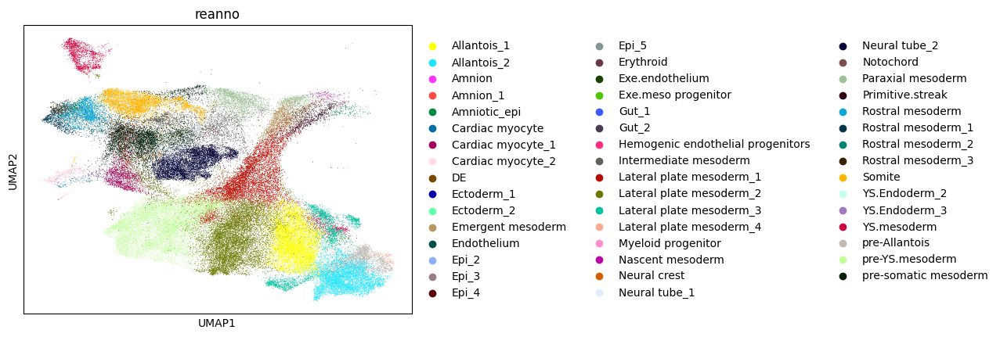

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


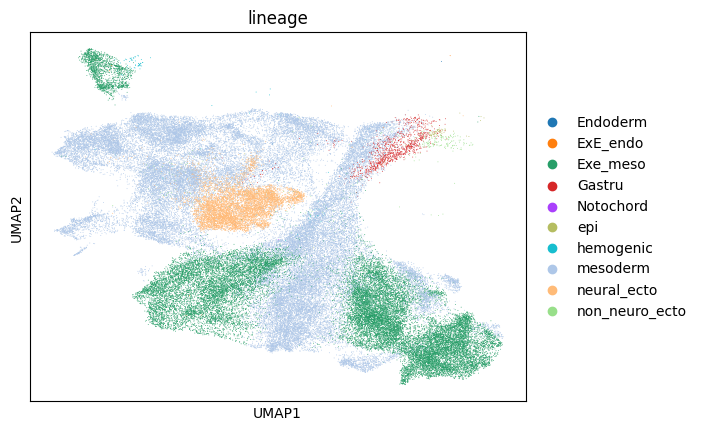

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


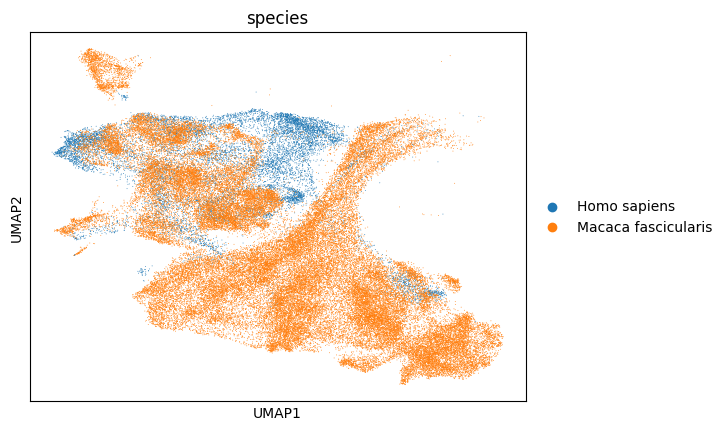

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


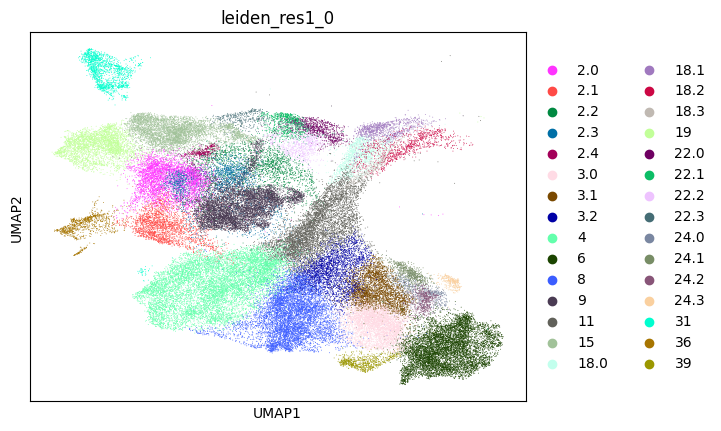

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


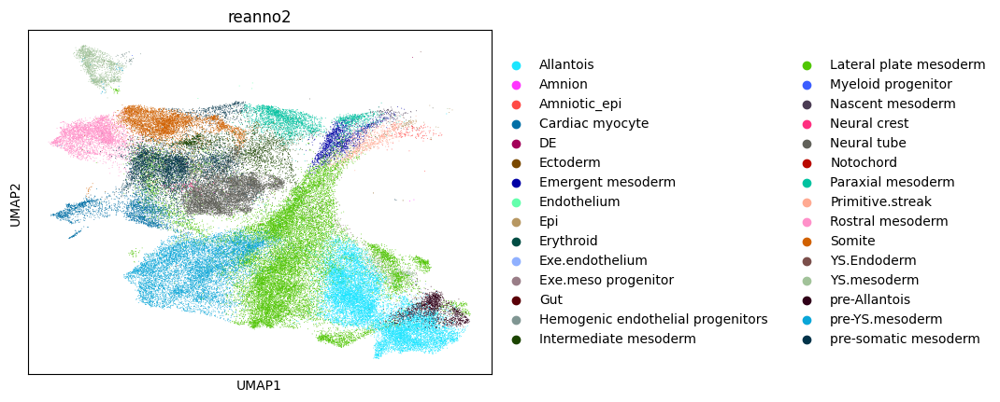

In [37]:
sc.pl.umap(ana_sub, color=['reanno'])
sc.pl.umap(ana_sub, color=['lineage'])
sc.pl.umap(ana_sub, color=['species'])
sc.pl.umap(ana_sub, color=['leiden_res1_0'])
sc.pl.umap(ana_sub, color=['reanno2'])

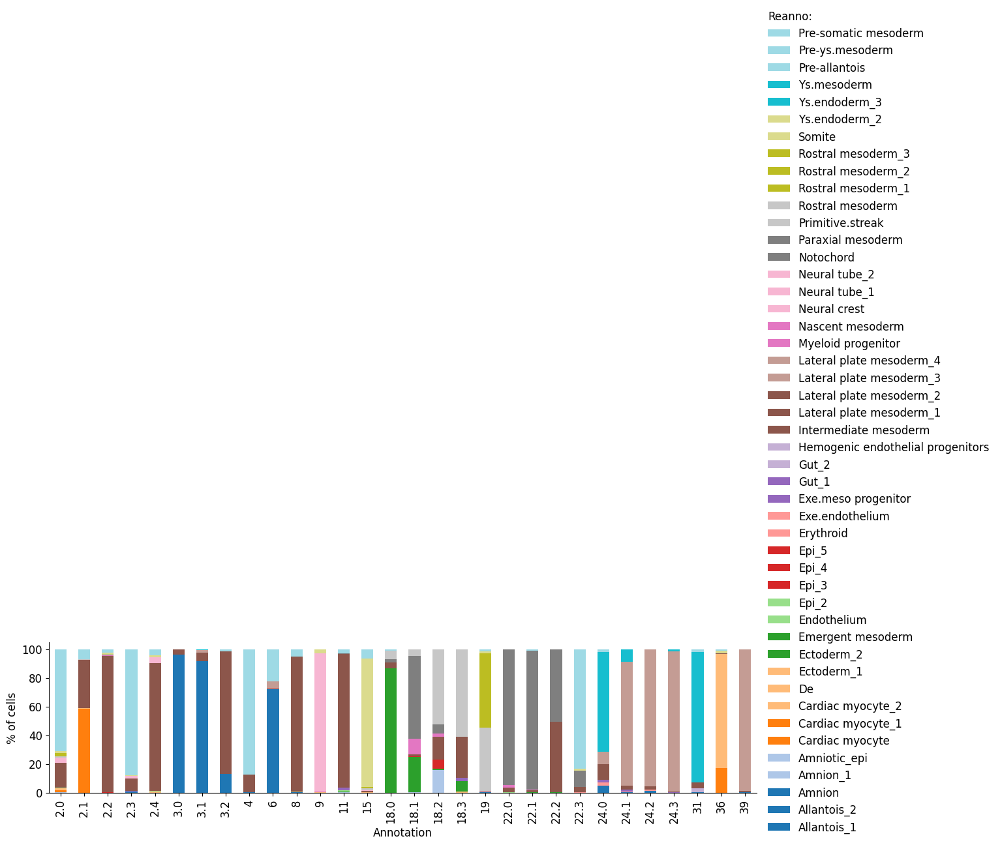

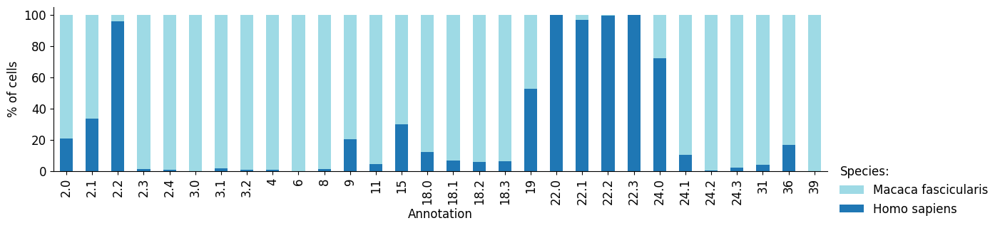

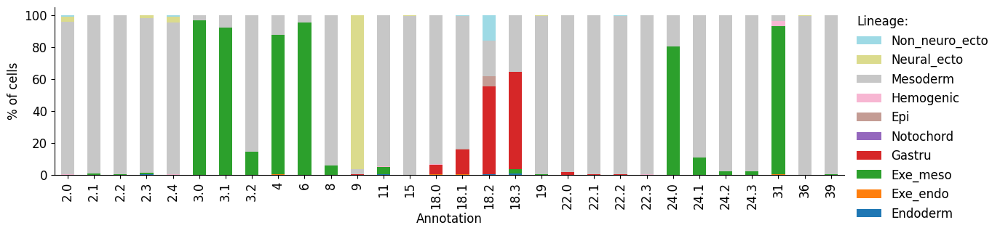

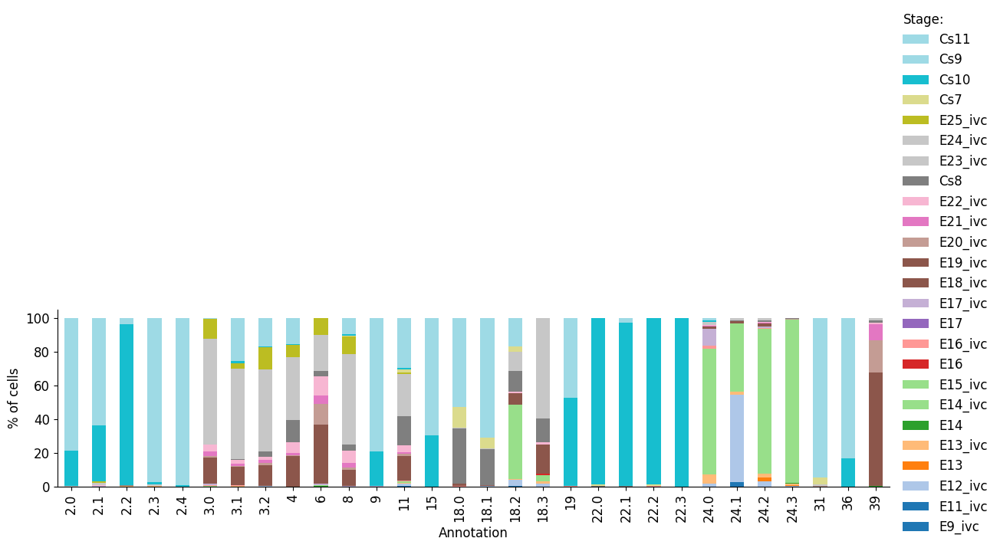

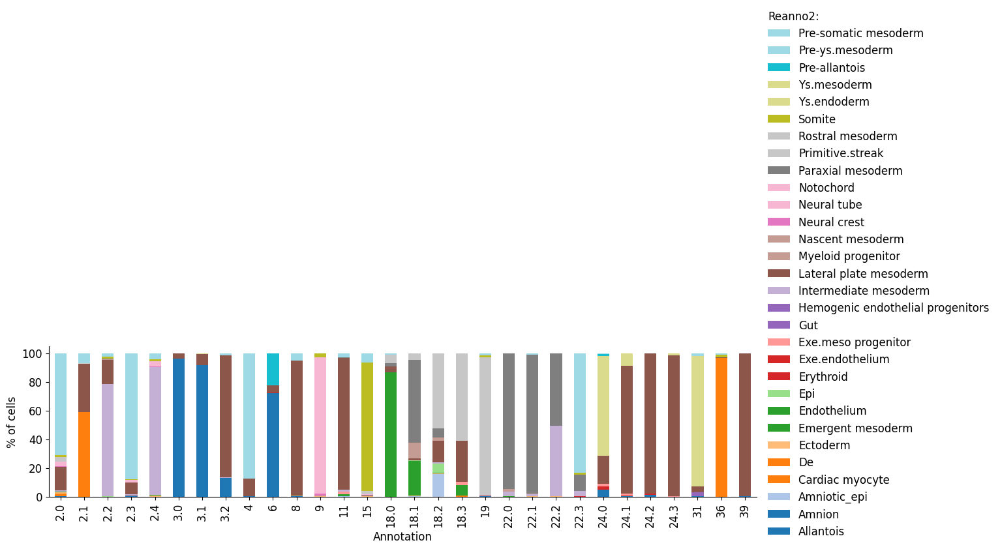

In [38]:
FIGURES = dict()
fz = 12
annos = ['reanno', 'species', 'lineage','stage','reanno2']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['leiden_res1_0'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [39]:
#dot plot
meso_marker_genes = {
    "Primitive.streak": ["TBXT", "SP5", "HOXA1", "CDX1", "CDX2","MIXL1", "FST" ],
    "meso.general":["PDGFRA", "MESP1",  "GATA6",],
    "emergent.meso": ["LEFTY2", "OTX2","LHX1" ],
    "Nascent.meso":["TBX6","MEIS1",],
    "Notochord":["CHRD", "NOTO"],
    "Axial.meso": ["DCLK1", "ESRG",],
    "Paraxial.meso":["MSGN1", "HES7", ],
    "Caudal.meso":[ "SFRP2", "HOXA1"],
    "Rostral.meso":[ "PITX2", "IRX3"],
    "Intermediate.meso":["PAX8", "OSR1", "EYA1", ],
    "lateral plate.meso":["HAND1", "MYL7","HAPLN1", "BMP4", "FOXF1", "SNAI2" ],
    "ExE mesoderm progenitor":["LUM", "POSTN", "IGF2", "ANXA1"],
   "YS mesoderm":[ "CREB3L1", "NR2F2", "PLAGL1", "ANXA1", "NID2"],
    #"Allantoic stalk":["CDX1", "CDX2", "FGF9", "FGF18", "SHH", "WNT5B", "MDK"],

   # "myocyte": ["PITX2", "TGFBI"],
    "cardio myocyte":["TNNT2", "MYL7", "TNNI1", "MYH10"],
    "somite":["ALDH1A2",  "MEOX2", "MEOX1",  "FOXC2"],

     "ecto.epi.general":[ "POU5F1", "DNMT3B","EPCAM","CLDN6"],
    #"radial glial":["CDH2", "NES",  "FABP7", "VIM"],
     "neural.ecto":["SOX3", "PAX6", "TTYH1"],
     "neural crest":["SOX10", "MPZ", "TFAP2A"],
     "neural tube":["SOX2", "OTX2", "RFX4"],
    "proliferating.meso": ["MKI67", "TOP2A", "CDK1" ],
    #"Amniotic.ecto": ["TFAP2C", "GATA3", "MSX2",  "WNT6","DLX5",],
        "EXM": ["DEPDC1B", "FBN2", "FRMD4B", "HAND2", "OAF"],
    "Allantois": ["COL6A2", "COL6A1",  "PCOLCE", "VCAN"],
   
}

In [40]:
#dot plot
epi_marker_genes = {
    "epi.general": [ "POU5F1","NANOG","SOX2",],
    "naïve Epi":["KLF4", "KLF17", "DNMT3L", "SOX15", "TFCP2L1", "ZFP42",],
    "primed Epi":["UTF1", "FGF2", "DNMT3B", "SOX11", "SFRP2", "SALL2" ,],
    "PostE-EPI": [ "UTF1", "FGF4", "NODAL",],
    "PostL-EPI": [ "IGFBP2", "USP44", "CD24",],
    "Amniotic.epi": ["TFAP2C", "GATA3", "MSX2", "TFAP2A", "WNT6","DLX5",],
    "Advanced amnion": ["GABRP", "IGFBP3", "IGFBP5",],
    "Anterior Epi": ["HESX1", "CER1", "LEFTY1","LEFTY2", "OTX2" ],
    "Primitive.streak": ["TBXT", "SP5", "HOXA1", "CDX1", "CDX2","MIXL1", "FST" ],
    "PGC":["NANOS3", "PDPN", "PRDM1"],
    "epithelium":[ "EPCAM","CLDN6"],
    "hypoblast":["GATA6","SOX17","PDGFRA"],
    "ExE.endoderm progenitor": ["PODXL", "CDH2", "APOA1", "IHH", "FOXA1", "FOXA2", "HNF4A",],
    "AVE":["LHX1", "HHEX", "EOMES", "GSC", "CER1", "LEFTY1", "LEFTY2","NOG"],
    "VE/YE":["AFP", "TTR", "APOA4", "APOC3","MTTP",],
    "YS endoderm": ["AFP","TTR","GJB1"], 
    "anterior endoderm": ["HHEX", "OTX2", "SHISA2", "CER1"],
    "Gastru endoderm":["APOA2","FOXA2","TTR",],
 
     
    #"Advanced mesoderm": ["HAND1", "BMP4","FOXF1", "SNAI2" ],
    "lateral plate.meso":["HAND1","KDR", "MYL7","HAPLN1" ],
    "ExE.mesoderm":["LUM", "POSTN", "IGF2", "ANXA1"],
    

    
   # "Allantoic stalk":[ "FGF9", "FGF18", "SHH", "WNT5B", "MDK"],
   #"ExE.mesoderm prog":["MSX1", "COL6A3"],
   # "Nascent ExE.meso":["IGFBP5", "IGFBP7"],
   # "AM.ExE.meso":["MSX2", "TEAD1"],
   # "YS.ExE.meso1":["GNRH2", "SPINK1"],
   # "YS.ExE.meso2":["MT2A", "A2M"],
   # "YS.mesothelium":["PODXL", "CDH1"],

    
     
}

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


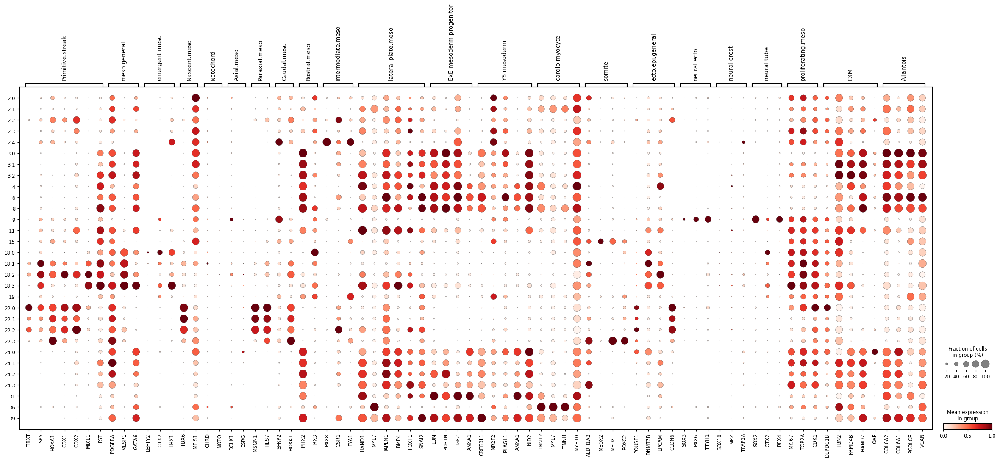

In [41]:
sc.pl.dotplot(ana_sub, meso_marker_genes, groupby="leiden_res1_0", use_raw=False, standard_scale="var")

In [42]:
# Check the categories of 'reanno_3'
categories_reanno_3 = ana_sub.obs['reanno_3'].cat.categories
print(categories_reanno_3)


Index(['NA'], dtype='object')


In [43]:
##rename clusters

ana_sub.obs['reanno_3'] = ana_sub.obs['leiden_res1_0'].cat.add_categories(['pre-YS.mesoderm','Allantois_2',
                                                                         'Lateral plate mesoderm_2','Neural tube',
                                                                         'Lateral plate mesoderm_1','Somite',
                                                                         'Rostral mesoderm','Lateral plate mesoderm_3',
                                                                         'YS.mesoderm','Cardiac myocyte','Lateral plate mesoderm_4',
                                                                          'pre-somatic mesoderm','Intermediate mesoderm',
                                                                         'Allantois_1','Emergent mesoderm',
                                                                         'Primitive streak',  'Paraxial mesoderm'])

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '4' ])] = 'pre-YS.mesoderm'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '6' ])] = 'Allantois_2'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '8'])] =  'Lateral plate mesoderm_2'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '9' ])] = 'Neural tube'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '11' ])] = 'Lateral plate mesoderm_1'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '15' ])] = 'Somite'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '19' ])] = 'Rostral mesoderm'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '24.0','24.1','24.2','24.3'])] = 'Lateral plate mesoderm_3'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '31' ])] = 'YS.mesoderm'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '36' ])] = 'Cardiac myocyte'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '39' ])] = 'Lateral plate mesoderm_4'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '2.0','2.3','22.3' ])] = 'pre-somatic mesoderm'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '2.2','2.4', ])] = 'Intermediate mesoderm'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '2.1', ])] = 'Cardiac myocyte'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '3.0','3.1' ])] = 'Allantois_1'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '3.2',])] = 'Lateral plate mesoderm_1'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '18.0', '18.3'])] = 'Emergent mesoderm'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '18.2',])] = 'Primitive streak'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '18.1','22.0','22.1','22.2' ])] = 'Paraxial mesoderm'


ana_sub.obs['reanno_3'] = ana_sub.obs['reanno_3'].cat.remove_unused_categories()

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


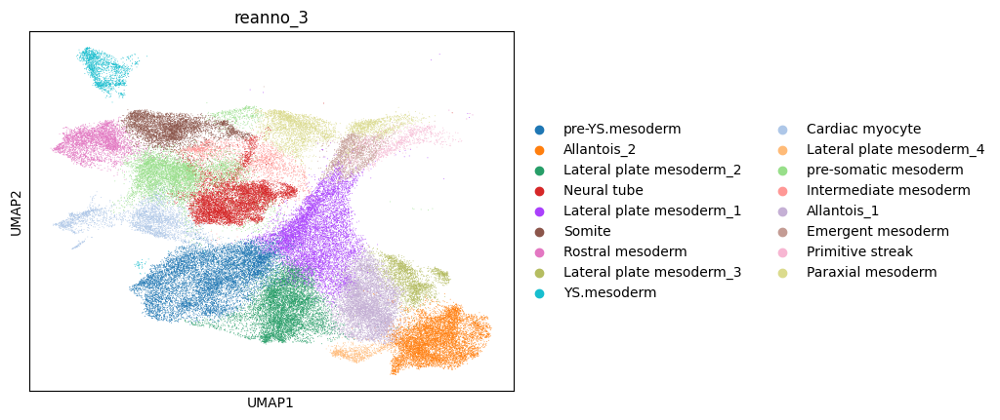

In [44]:
sc.pl.umap(ana_sub, color=['reanno_3'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


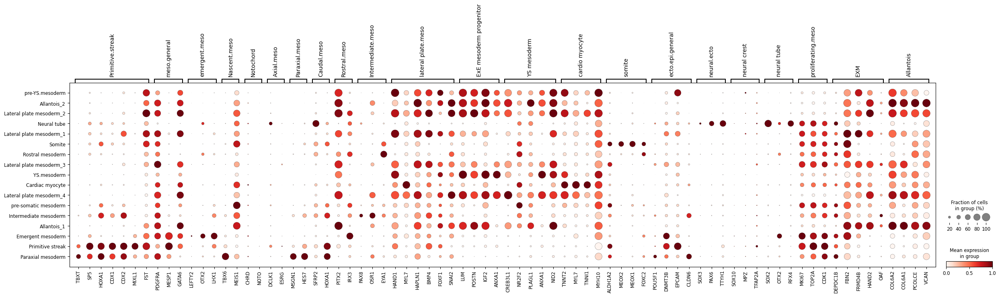

In [45]:
sc.pl.dotplot(ana_sub, meso_marker_genes, groupby="reanno_3", use_raw=False, standard_scale="var")

In [46]:
# Extract the sub-cluster labels
sub_cluster_labels = ana_sub.obs['reanno_3']

# Combine the categories
combined_categories = pd.CategoricalDtype(categories=list(set(adata.obs['reanno_3'].cat.categories).union(set(sub_cluster_labels.cat.categories))))

# Convert both columns to the combined categories
adata.obs['reanno_3'] = adata.obs['reanno_3'].astype(combined_categories)
sub_cluster_labels = sub_cluster_labels.astype(combined_categories)

# Ensure indices in ann_sub are a subset of those in adata
assert set(ana_sub.obs.index).issubset(set(adata.obs.index)), "Indices in ann_sub are not a subset of those in adata"

# Update 'reanno' in adata with the values from sub_cluster_labels
adata.obs.loc[ana_sub.obs.index, 'reanno_3'] = sub_cluster_labels.loc[ana_sub.obs.index]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


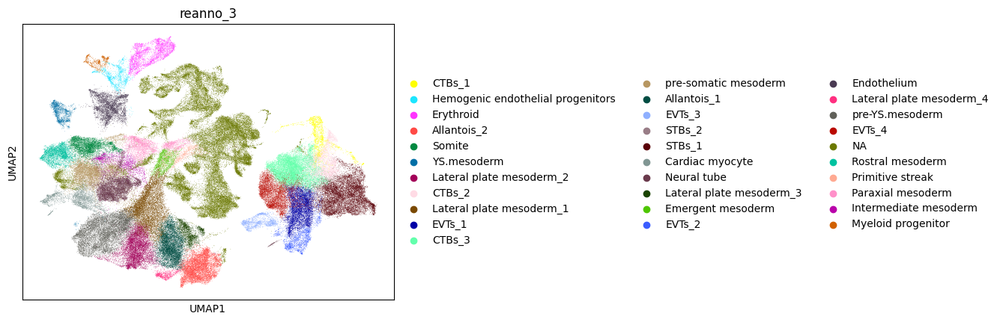

In [47]:
sc.pl.umap(adata, color=['reanno_3'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


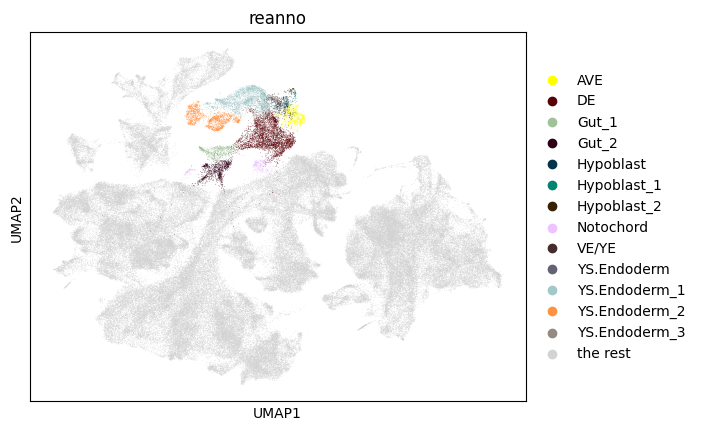

In [48]:
# Plot UMAP with specified colors and groups
ax = sc.pl.umap(adata, color=["reanno"], groups=[ 'Hypoblast', 'AVE','VE/YE','YS.Endoderm', 'DE','Notochord', 
                                                 'Hypoblast_1','Hypoblast_2','VE/YE','AVE','Gut_1','Gut_2','YS.Endoderm_1','YS.Endoderm_2','YS.Endoderm_3',
             'DE','Node',], show=False)

# Change legend text from "NA" to "the rest"
legend_texts = ax.get_legend().get_texts()
for legend_text in legend_texts:
    if legend_text.get_text() == "NA":
        legend_text.set_text("the rest")


In [49]:
# focusing on blood lineage
ana_sub= adata[adata.obs['reanno'].isin([ 'Hypoblast_1', 'Hypoblast_2', 'VE/YE', 'AVE', 'YS.Endoderm_1', 'YS.Endoderm_2', 'YS.Endoderm_3',
                  'Hypoblast', 'AVE', 'VE/YE', 'YS.Endoderm','DE', 'Gut_1', 'Gut_2','Notochord', 'Node', ])] 

In [50]:
# Use value_counts to count the number of cells in each cluster
cluster_counts = ana_sub.obs['leiden_res1_0'].value_counts()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Print the counts
print(cluster_counts)


28      2010
17.0    1578
17.1    1538
13.0    1423
34      1118
13.1     913
37       884
13.2     718
13.3     640
13.4     629
13.5     479
17.2     465
17.3     196
13.6     121
43       121
13.7      58
17.4      28
23        23
4          7
5.0        6
11         5
7          5
21         5
18.3       3
5.4        3
31         3
25         3
2.3        2
1          2
5.2        2
18.2       1
9          1
18.0       1
5.1        1
27.7       1
3.2        1
3.0        1
2.0        1
18.1       1
Name: leiden_res1_0, dtype: int64


In [51]:
# Subset the clusters that have more than 10 counts
clusters_to_keep = cluster_counts[cluster_counts > 100].index

# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_res1_0'].isin(clusters_to_keep)]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


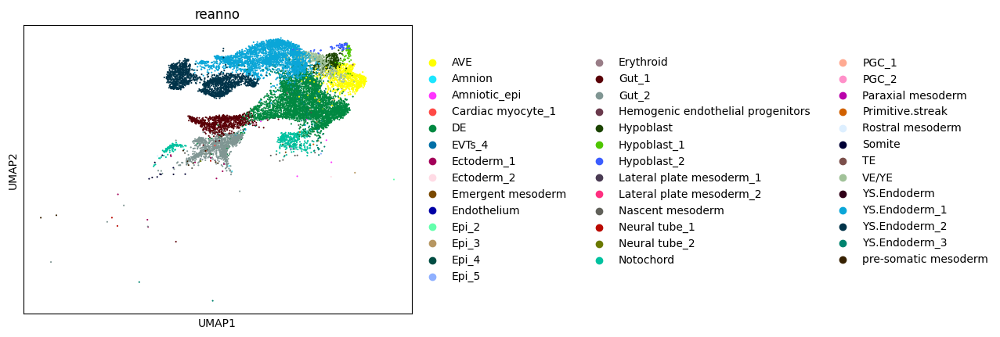

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


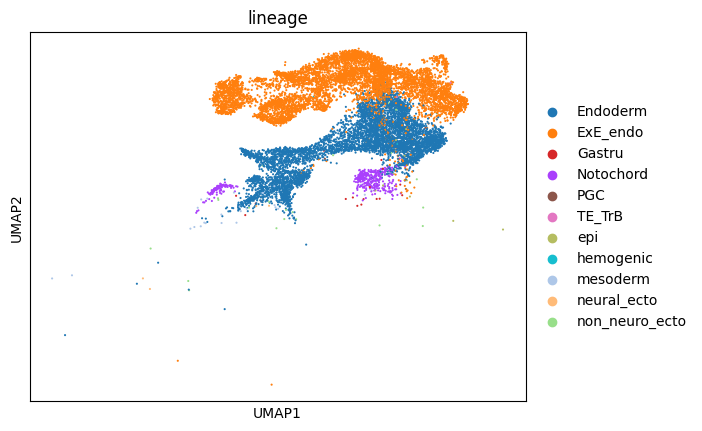

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


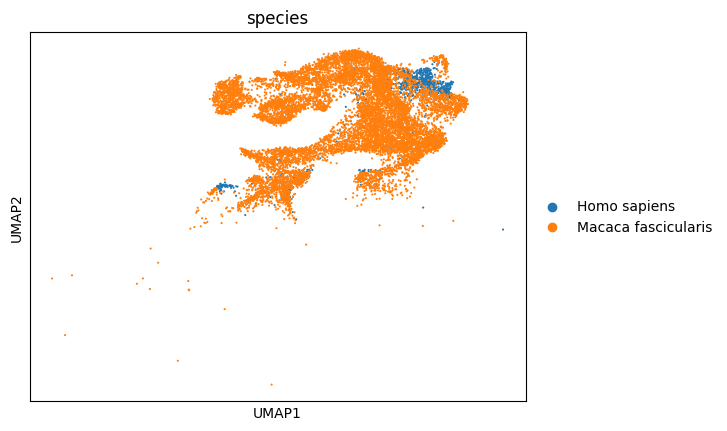

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


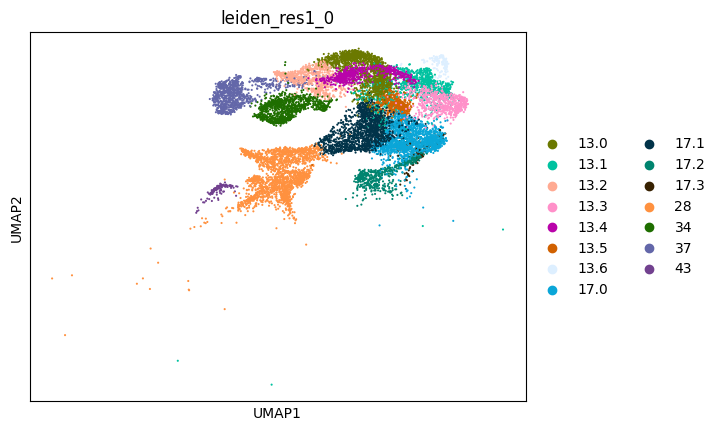

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


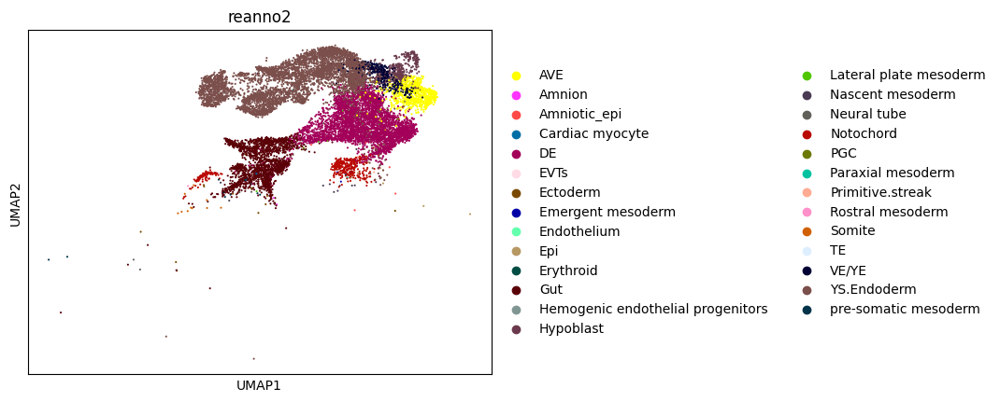

In [52]:
sc.pl.umap(ana_sub, color=['reanno'])
sc.pl.umap(ana_sub, color=['lineage'])
sc.pl.umap(ana_sub, color=['species'])
sc.pl.umap(ana_sub, color=['leiden_res1_0'])
sc.pl.umap(ana_sub, color=['reanno2'])

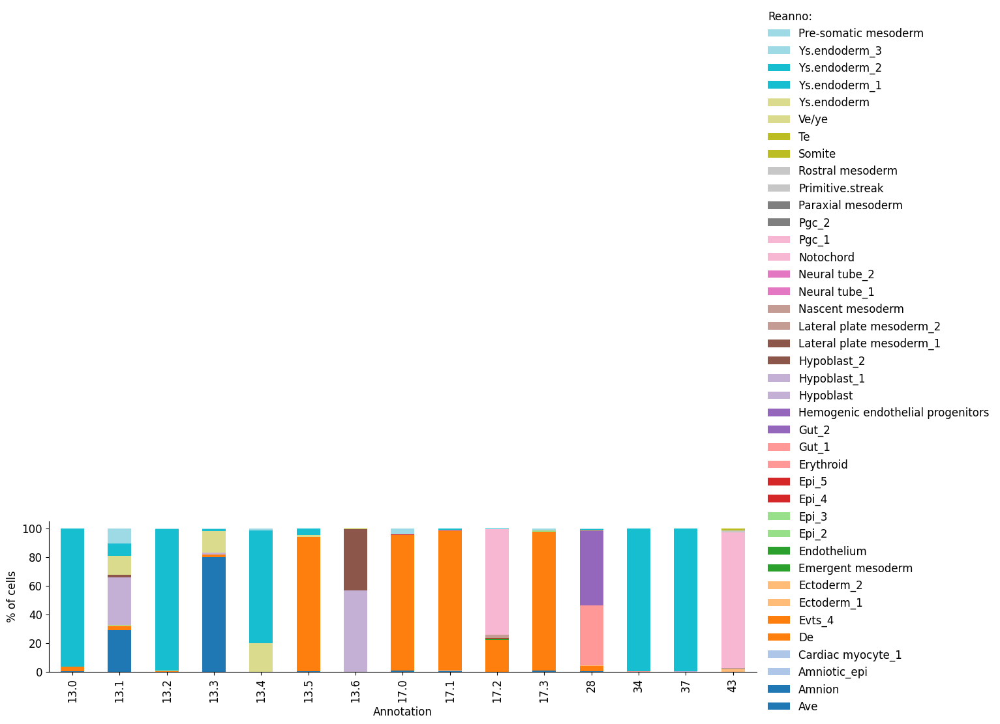

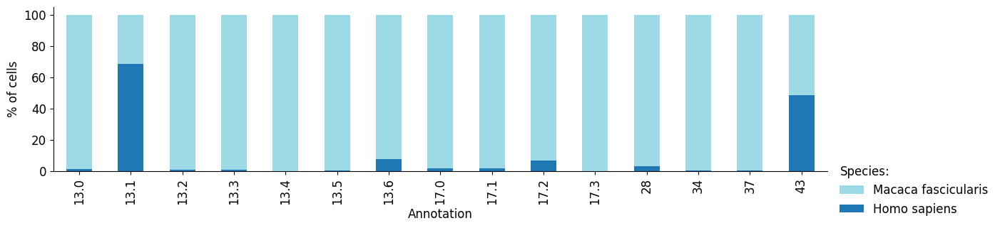

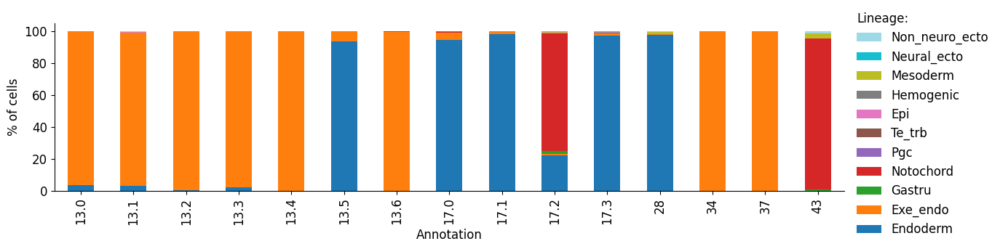

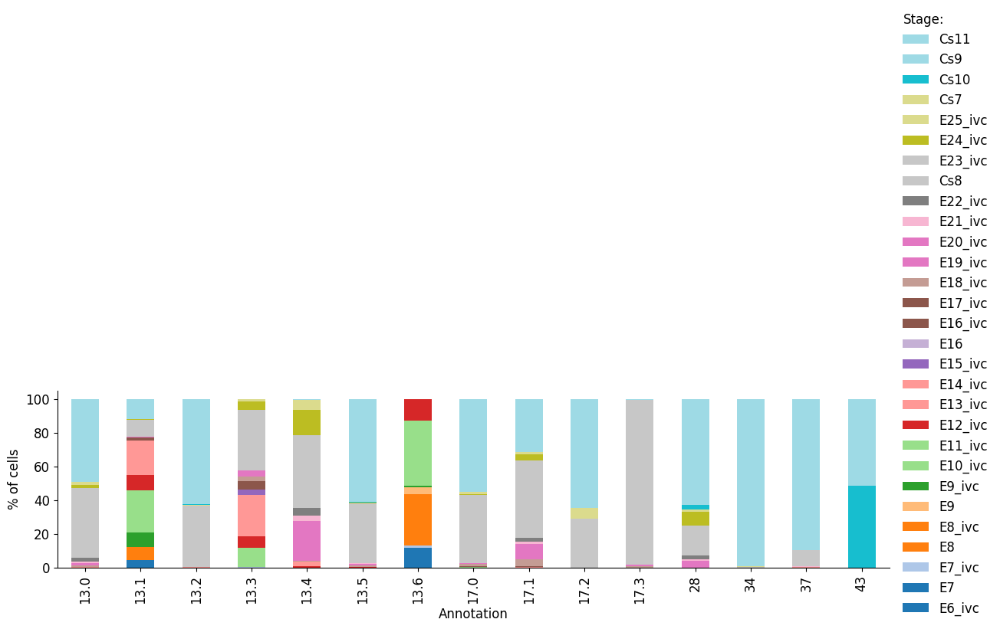

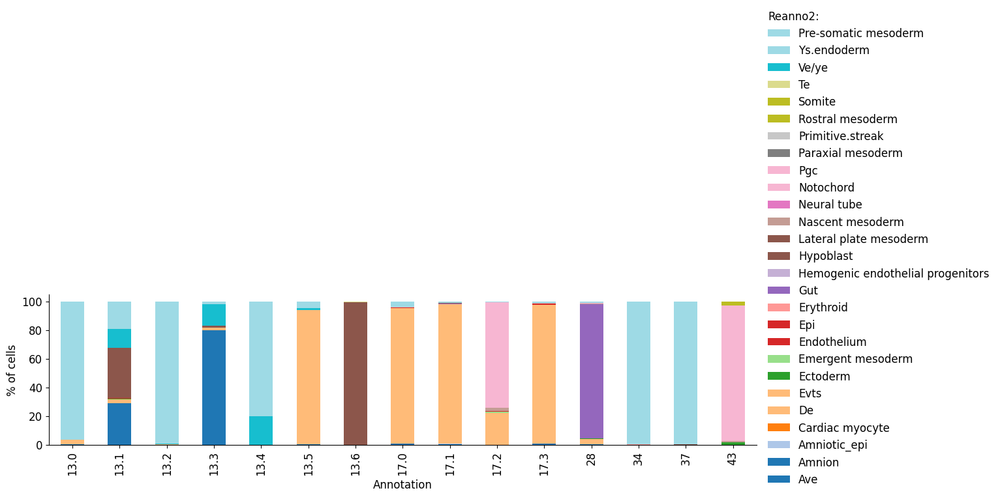

In [53]:
FIGURES = dict()
fz = 12
annos = ['reanno', 'species', 'lineage','stage','reanno2']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['leiden_res1_0'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


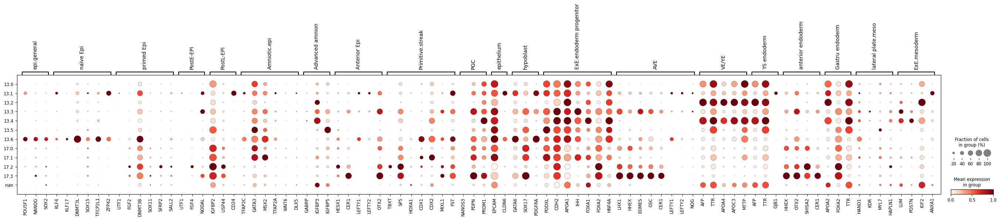

In [54]:
sc.pl.dotplot(ana_sub, epi_marker_genes, groupby="leiden_res1_0_sub", use_raw=False, standard_scale="var")

In [55]:
##rename clusters

ana_sub.obs['reanno_3'] = ana_sub.obs['leiden_res1_0'].cat.add_categories(['Gut','YS.Endoderm_2','Notochord','AVE','YS.Endoderm_1',
                                                                          'DE','Hypoblast',])

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '28' ])] = 'Gut'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '34' ])] = 'YS.Endoderm_2'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '37'])] =  'YS.Endoderm_2'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '43' ])] = 'Notochord'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '13.1','13.3' ])] = 'AVE'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '13.0','13.2', '13.4'])] = 'YS.Endoderm_1'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], ['17.0','17.1', '17.3','13.5'])] = 'DE'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '13.6'])] = 'Hypoblast'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '17.2'])] = 'Notochord'



ana_sub.obs['reanno_3'] = ana_sub.obs['reanno_3'].cat.remove_unused_categories()

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


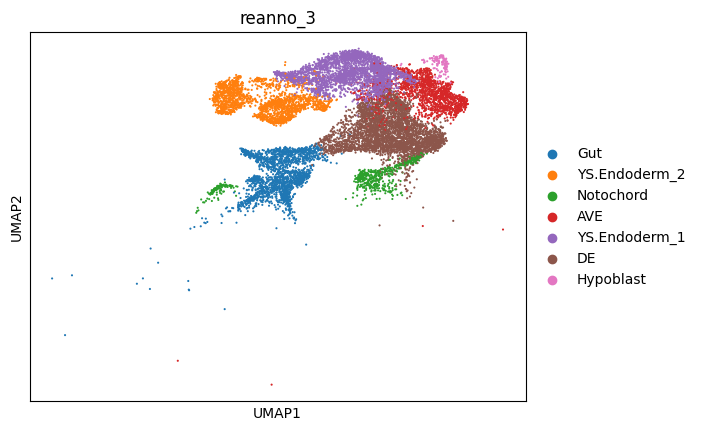

In [56]:
sc.pl.umap(ana_sub, color=['reanno_3'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


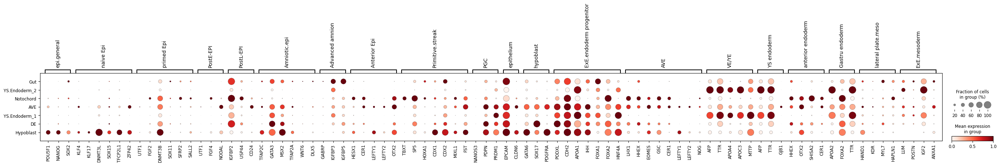

In [57]:
sc.pl.dotplot(ana_sub, epi_marker_genes, groupby="reanno_3", use_raw=False, standard_scale="var")

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


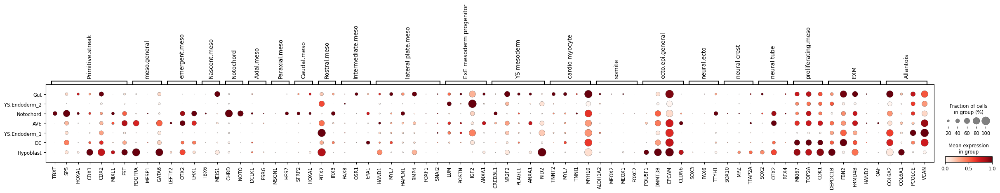

In [58]:
sc.pl.dotplot(ana_sub, meso_marker_genes, groupby="reanno_3", use_raw=False, standard_scale="var")

In [59]:
# Extract the sub-cluster labels
sub_cluster_labels = ana_sub.obs['reanno_3']

# Combine the categories
combined_categories = pd.CategoricalDtype(categories=list(set(adata.obs['reanno_3'].cat.categories).union(set(sub_cluster_labels.cat.categories))))

# Convert both columns to the combined categories
adata.obs['reanno_3'] = adata.obs['reanno_3'].astype(combined_categories)
sub_cluster_labels = sub_cluster_labels.astype(combined_categories)

# Ensure indices in ann_sub are a subset of those in adata
assert set(ana_sub.obs.index).issubset(set(adata.obs.index)), "Indices in ann_sub are not a subset of those in adata"

# Update 'reanno' in adata with the values from sub_cluster_labels
adata.obs.loc[ana_sub.obs.index, 'reanno_3'] = sub_cluster_labels.loc[ana_sub.obs.index]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


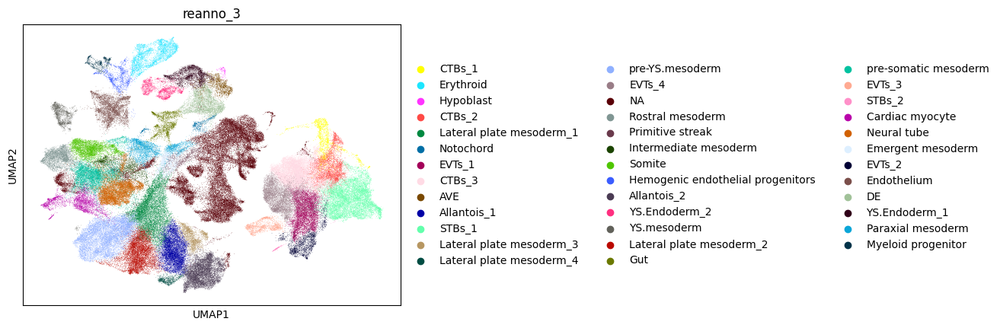

In [60]:
sc.pl.umap(adata, color=['reanno_3'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


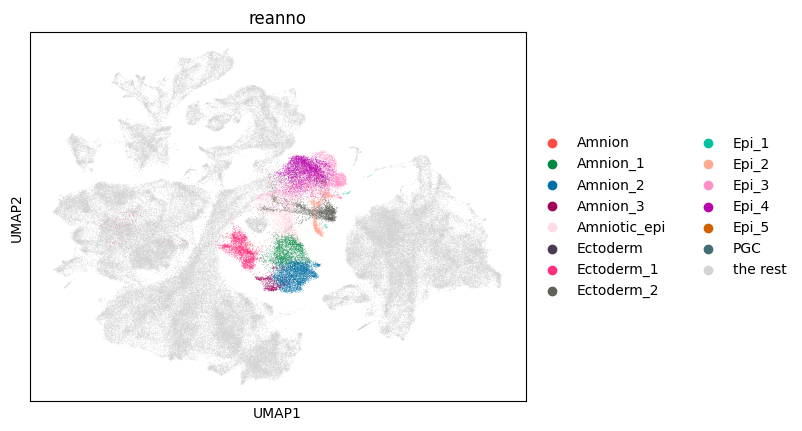

In [61]:
# Plot UMAP with specified colors and groups
ax = sc.pl.umap(adata, color=["reanno"], groups=[  'Epi_1','Epi_2','Epi_3','Epi_4',
                 'Amnion', 'Amniotic_epi', 'Ectoderm',
                 'Epi_1','Epi_2','Epi_3','Epi_4','Epi_5','Epi_6','Amniotic_epi','Amnion_1','Amnion_2','Amnion_3',
                                                'Epithelium','Ectoderm_1','Ectoderm_2','PGC'], show=False)

# Change legend text from "NA" to "the rest"
legend_texts = ax.get_legend().get_texts()
for legend_text in legend_texts:
    if legend_text.get_text() == "NA":
        legend_text.set_text("the rest")


In [62]:
# focusing on blood lineage
ana_sub= adata[adata.obs['reanno'].isin([  'Epi_1','Epi_2','Epi_3','Epi_4',
                 'Amnion', 'Amniotic_epi', 'Ectoderm',
                 'Epi_1','Epi_2','Epi_3','Epi_4','Epi_5','Epi_6','Amniotic_epi','Amnion_1','Amnion_2','Amnion_3',
                                                'Epithelium','Ectoderm_1','Ectoderm_2','PGC' ])] 

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


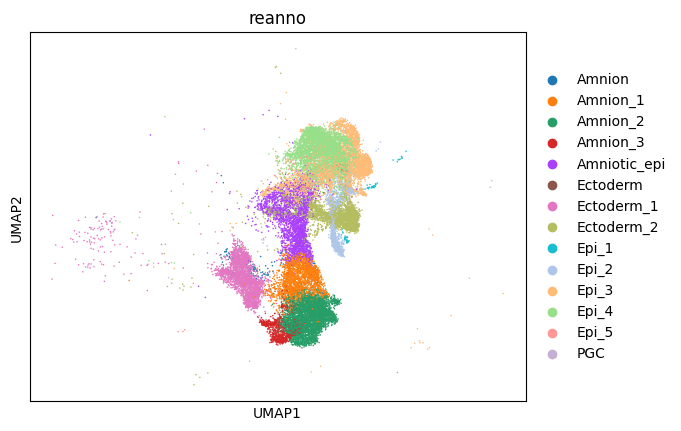

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


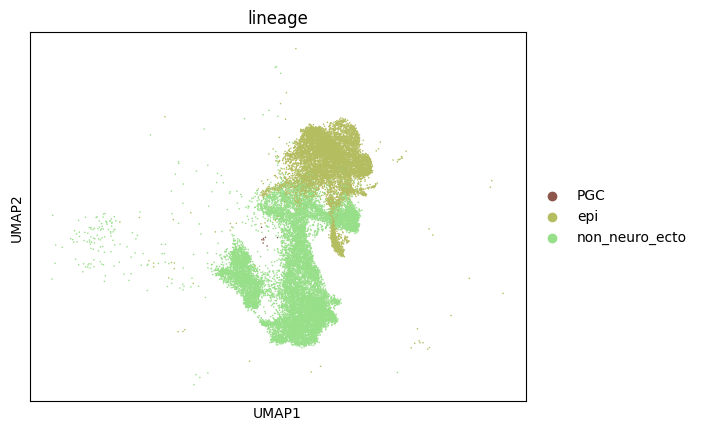

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


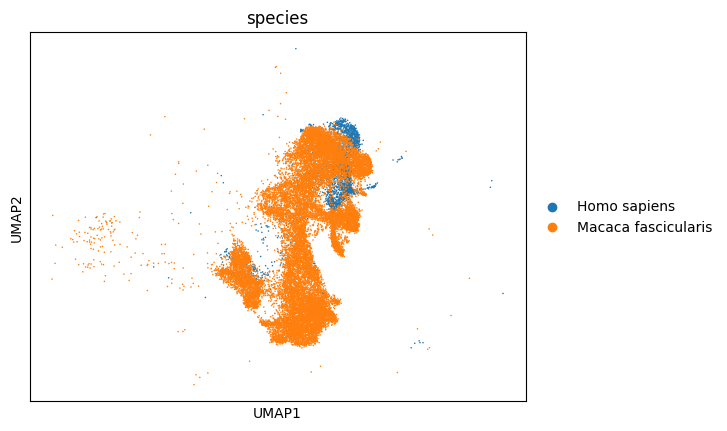

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


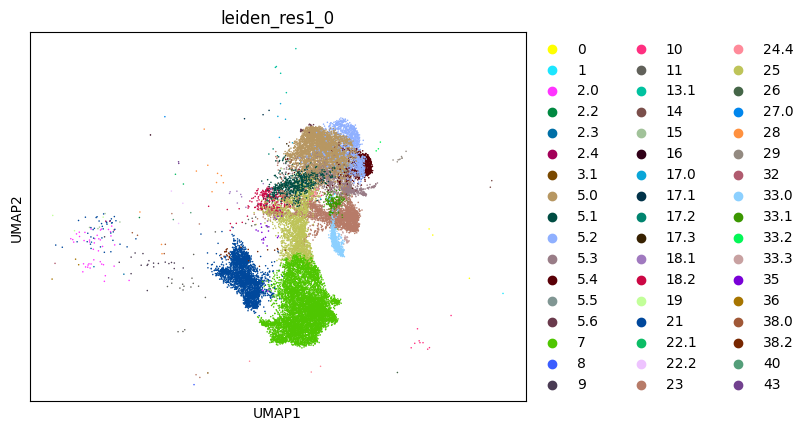

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


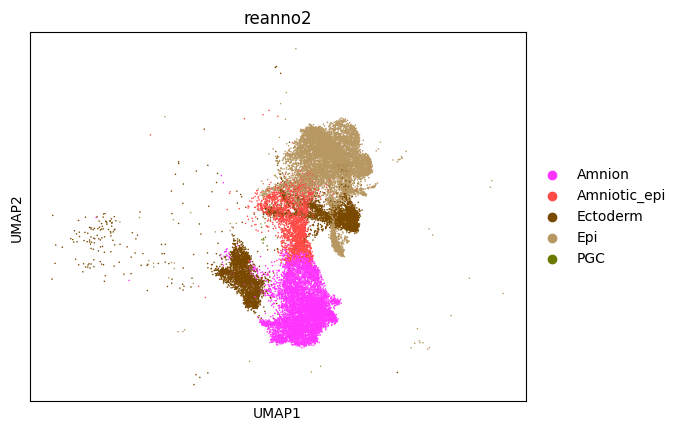

In [63]:
sc.pl.umap(ana_sub, color=['reanno'])
sc.pl.umap(ana_sub, color=['lineage'])
sc.pl.umap(ana_sub, color=['species'])
sc.pl.umap(ana_sub, color=['leiden_res1_0'])
sc.pl.umap(ana_sub, color=['reanno2'])

In [64]:
# Use value_counts to count the number of cells in each cluster
cluster_counts = ana_sub.obs['leiden_res1_0'].value_counts()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Print the counts
print(cluster_counts)

7       7116
5.0     3839
21      2922
23      2554
25      2220
5.2     1427
5.3     1238
5.1      808
5.4      788
33.0     617
33.1     317
18.2     213
5.5      128
2.0       46
38.2      33
33.3      28
5.6       27
35        26
11        26
24.4      25
9         21
10        12
28        11
17.0       9
29         9
18.1       8
13.1       7
19         6
15         5
38.0       4
33.2       3
36         3
0          3
17.2       3
22.2       3
2.3        3
2.4        3
1          3
17.1       3
22.1       2
40         2
14         2
43         2
17.3       2
32         1
8          1
3.1        1
27.0       1
2.2        1
26         1
16         1
Name: leiden_res1_0, dtype: int64


In [65]:
# Subset the clusters that have more than 10 counts
clusters_to_keep = cluster_counts[cluster_counts > 300].index

# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_res1_0'].isin(clusters_to_keep)]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


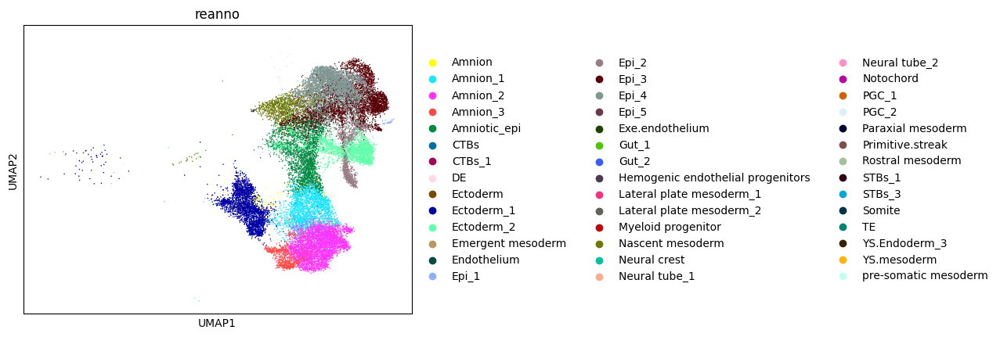

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


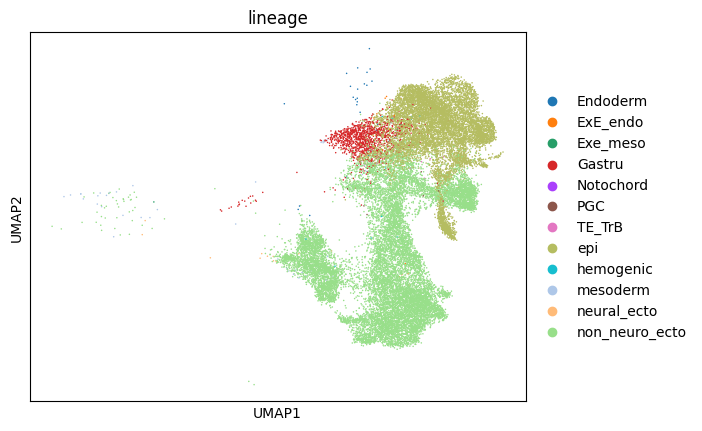

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


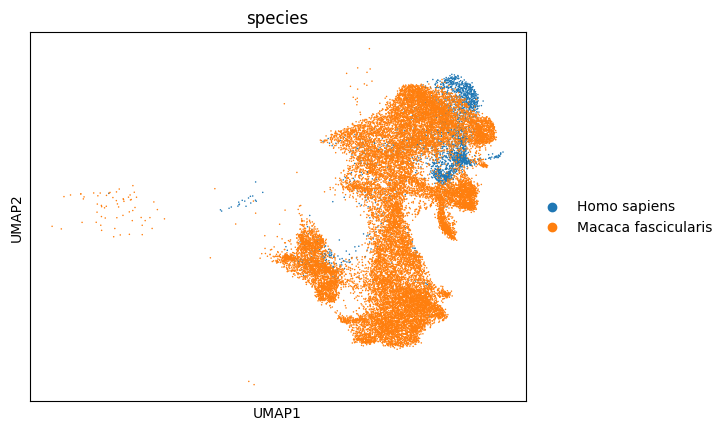

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


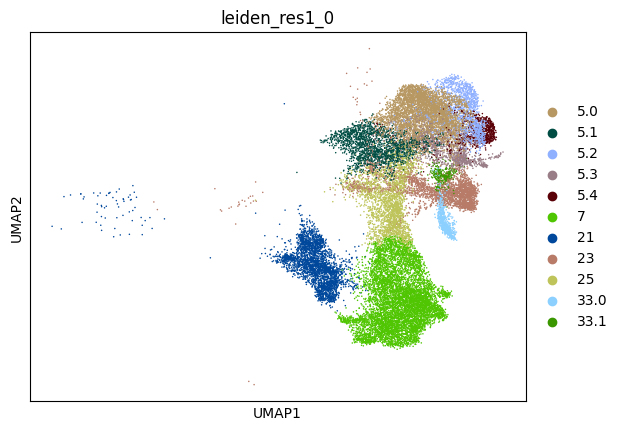

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


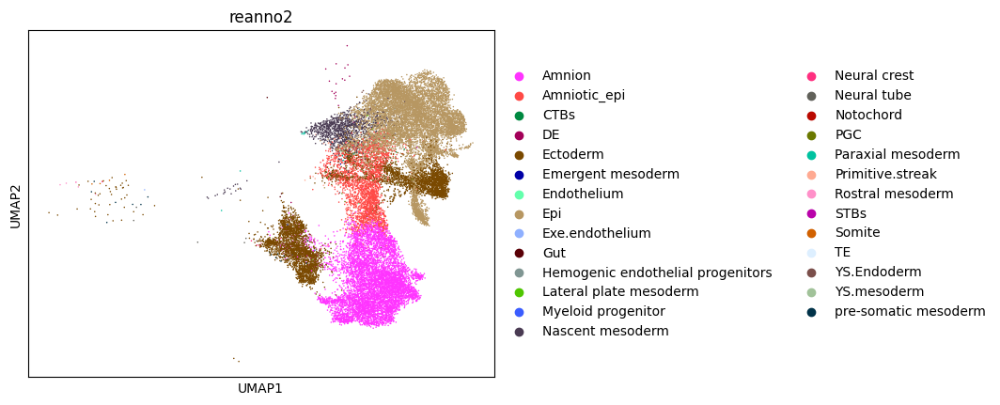

In [66]:
sc.pl.umap(ana_sub, color=['reanno'])
sc.pl.umap(ana_sub, color=['lineage'])
sc.pl.umap(ana_sub, color=['species'])
sc.pl.umap(ana_sub, color=['leiden_res1_0'])
sc.pl.umap(ana_sub, color=['reanno2'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


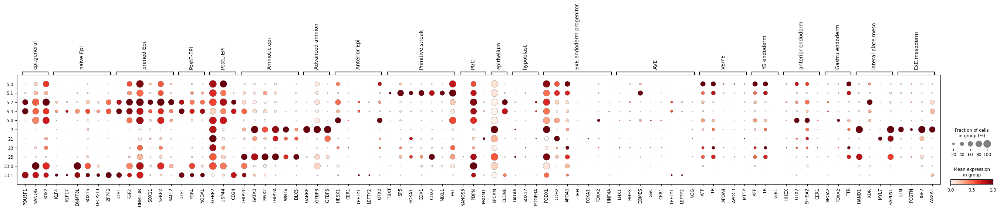

In [67]:
sc.pl.dotplot(ana_sub, epi_marker_genes, groupby="leiden_res1_0", use_raw=False, standard_scale="var")

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


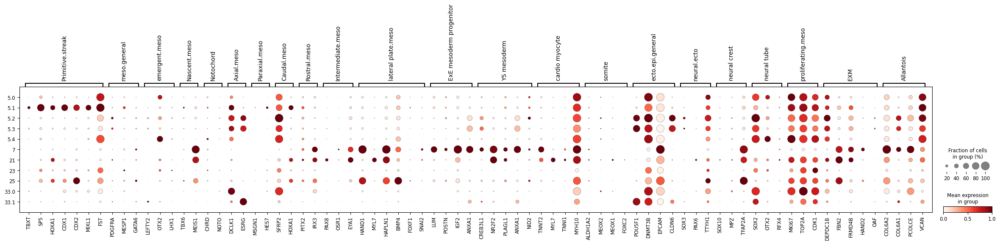

In [68]:
sc.pl.dotplot(ana_sub, meso_marker_genes, groupby="leiden_res1_0", use_raw=False, standard_scale="var")

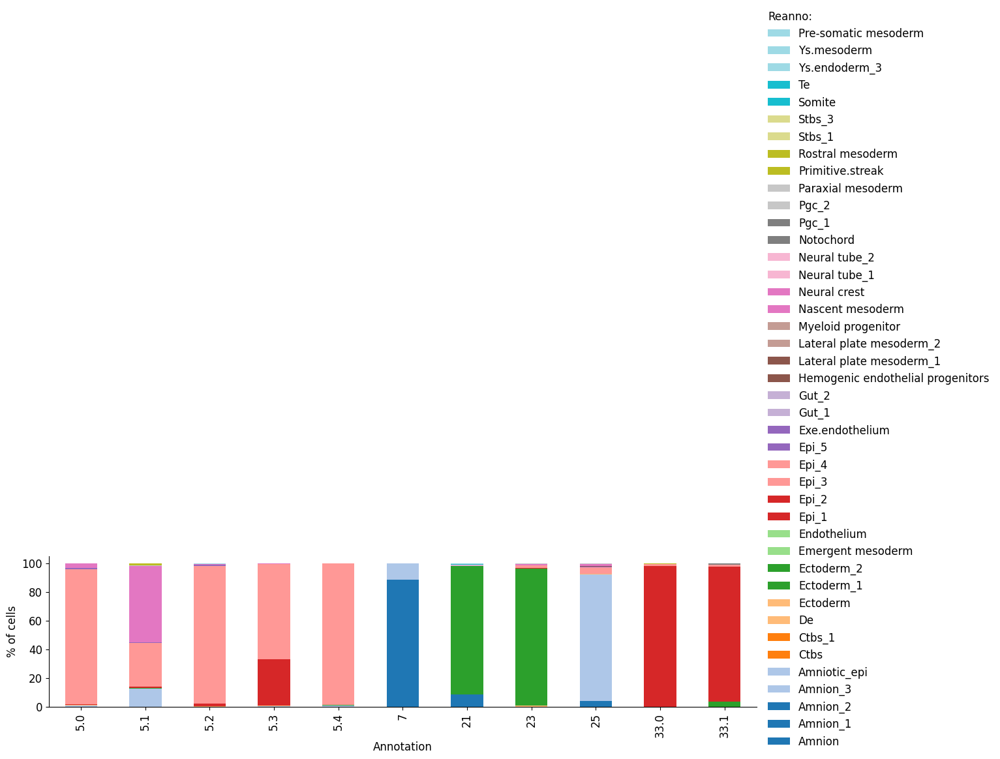

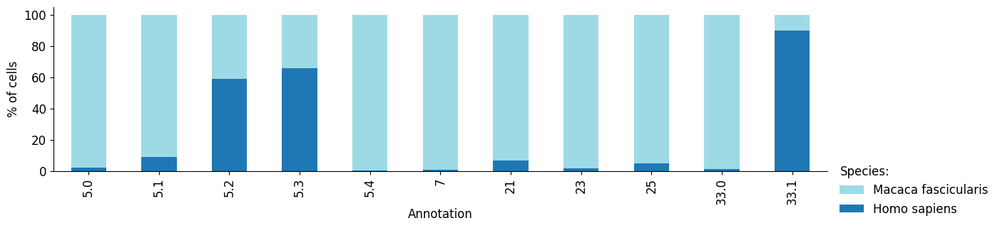

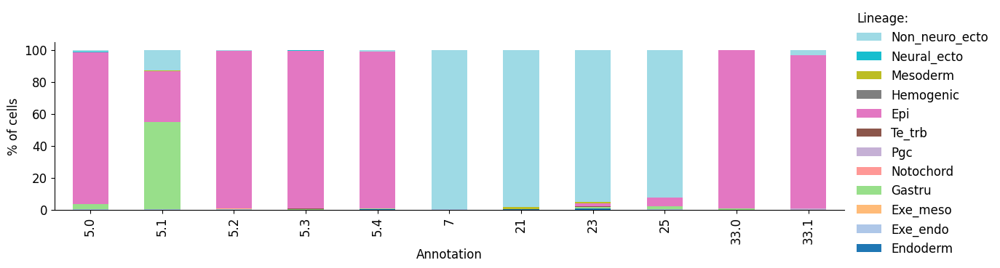

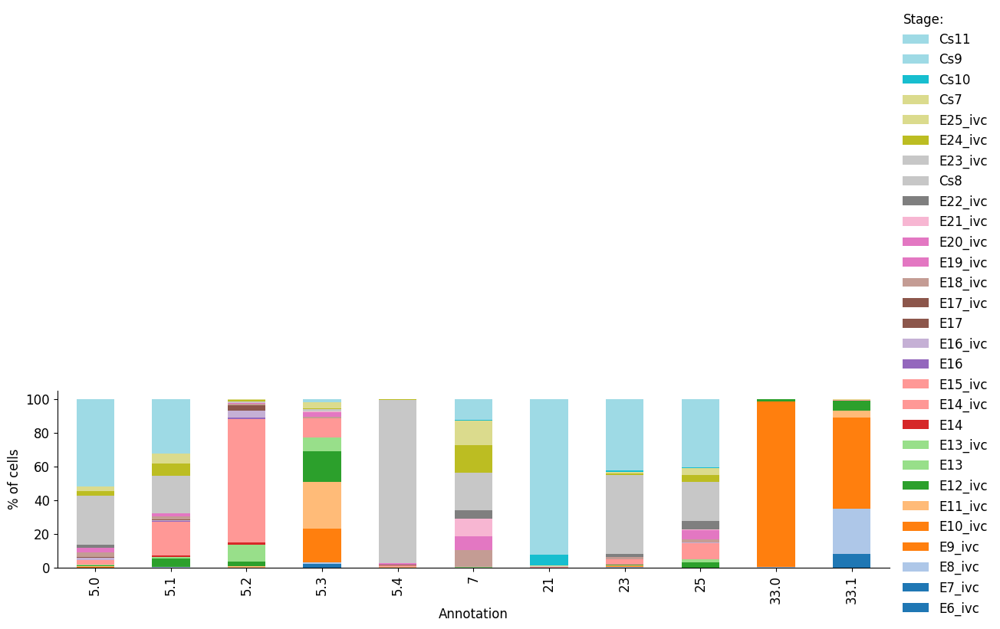

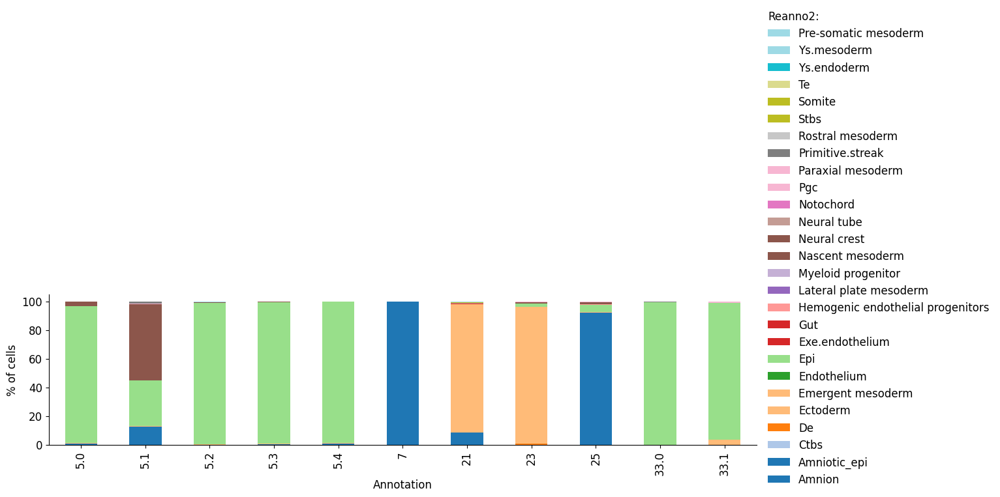

In [69]:
FIGURES = dict()
fz = 12
annos = ['reanno', 'species', 'lineage','stage','reanno2']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['leiden_res1_0'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [70]:
##rename clusters

ana_sub.obs['reanno_3'] = ana_sub.obs['leiden_res1_0'].cat.add_categories(['Amniotic_epi','Amnion','Ectoderm_1','Ectoderm_2','Epi_3',
                                                                          'Primitive streak','Epi_1','Epi_2'])

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '25', ])] = 'Amniotic_epi'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '7', ])] = 'Amnion'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '21', ])] = 'Ectoderm_1'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '23', ])] = 'Ectoderm_2'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '33.0','33.1', ])] = 'Epi_1'



ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '5.1', ])] = 'Primitive streak'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '5.2','5.3',  ])] = 'Epi_2'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '5.0','5.4',  ])] = 'Epi_3'


ana_sub.obs['reanno_3'] = ana_sub.obs['reanno_3'].cat.remove_unused_categories()

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


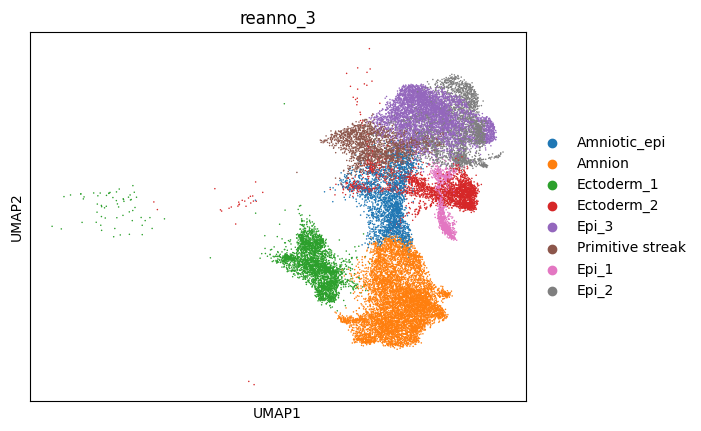

In [71]:
sc.pl.umap(ana_sub, color=['reanno_3'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


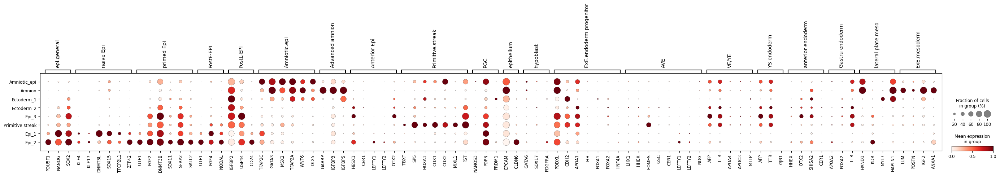

In [72]:
sc.pl.dotplot(ana_sub, epi_marker_genes, groupby="reanno_3", use_raw=False, standard_scale="var")

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


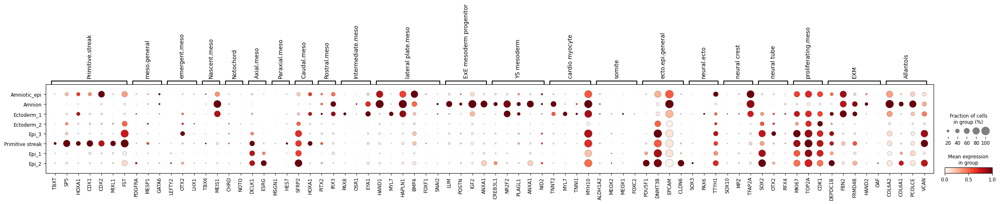

In [73]:
sc.pl.dotplot(ana_sub, meso_marker_genes, groupby="reanno_3", use_raw=False, standard_scale="var")

In [74]:
# Extract the sub-cluster labels
sub_cluster_labels = ana_sub.obs['reanno_3']

# Combine the categories
combined_categories = pd.CategoricalDtype(categories=list(set(adata.obs['reanno_3'].cat.categories).union(set(sub_cluster_labels.cat.categories))))

# Convert both columns to the combined categories
adata.obs['reanno_3'] = adata.obs['reanno_3'].astype(combined_categories)
sub_cluster_labels = sub_cluster_labels.astype(combined_categories)

# Ensure indices in ann_sub are a subset of those in adata
assert set(ana_sub.obs.index).issubset(set(adata.obs.index)), "Indices in ann_sub are not a subset of those in adata"

# Update 'reanno' in adata with the values from sub_cluster_labels
adata.obs.loc[ana_sub.obs.index, 'reanno_3'] = sub_cluster_labels.loc[ana_sub.obs.index]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


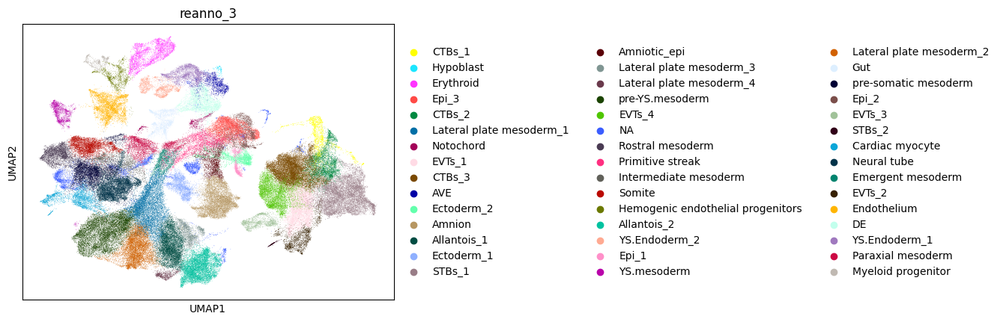

In [75]:
sc.pl.umap(adata, color=['reanno_3'])

In [76]:
# Check if 'PGC' is in the categories of 'reanno_3'
if 'PGC' not in adata.obs['reanno_3'].cat.categories:
    # Add 'PGC' to the categories
    adata.obs['reanno_3'] = adata.obs['reanno_3'].cat.add_categories('PGC')

# Now you can safely assign the new value
adata.obs.loc[adata.obs['leiden_res1_0'] == '35', 'reanno_3'] = 'PGC'

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


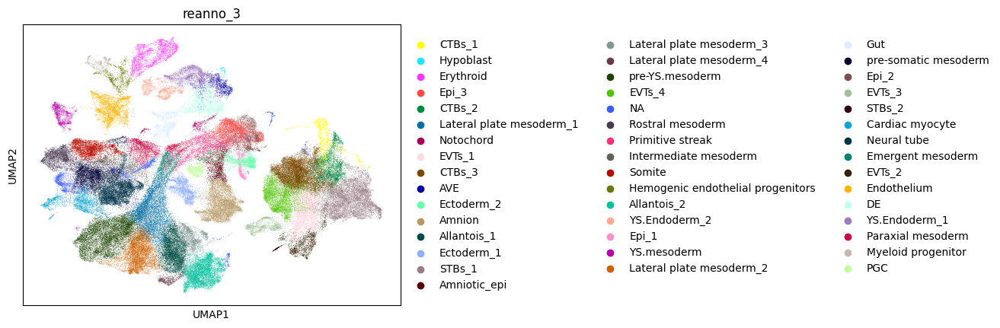

In [77]:
sc.pl.umap(adata, color=['reanno_3'])

In [78]:
# Drop unused categories from the 'reanno' column
adata.obs['reanno_3'] = adata.obs['reanno_3'].cat.remove_unused_categories()

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


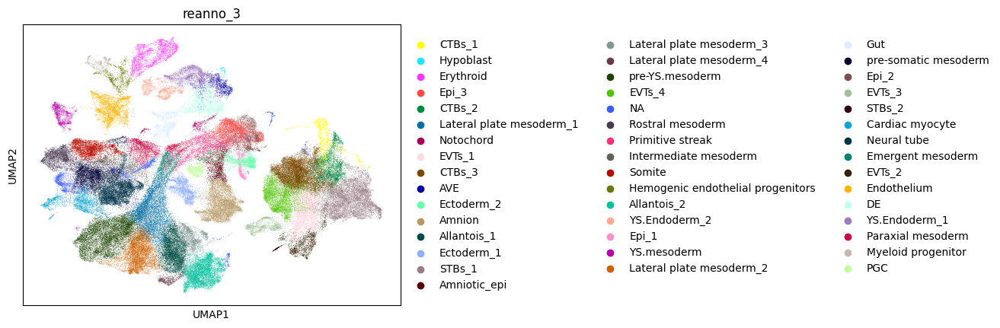

In [79]:
sc.pl.umap(adata, color=['reanno_3'])

In [80]:
na_rows = adata.obs[adata.obs['reanno_3'] == 'NA']
reanno_na = na_rows['leiden_res1_0']
print(reanno_na)

GATCGATTCCGGCACA-1_1_1_1_1_1                      42
TGGCCAGGTGGCTCCA-1_1_1_1_1_1                      42
TTCTCCTAGTTCCACA-1_1_1_1_1_1                      42
AAATGGATCACTTGTT-1_1_1_1                          42
AACCTGACATGGACAG-1_1_1_1                          42
AAGACAACAAACTCTG-1_1_1_1                          42
AATGGAACATGGTGGA-1_1_1_1                          42
ACAAGCTGTGGGATTG-1_1_1_1                          42
AGATCGTTCCCTTTGG-1_1_1_1                          42
AGTTCCCTCAAGCTTG-1_1_1_1                          42
ATGGAGGGTGGTCCCA-1_1_1_1                          42
ATTCCTAGTCTCTCTG-1_1_1_1                         5.6
CAACCTCTCGAGCCTG-1_1_1_1                          42
CAAGAGGGTCTACACA-1_1_1_1                          42
CATGCTCAGGTGTGAC-1_1_1_1                          42
CCAATGATCCTTTAGT-1_1_1_1                          42
CCACCATGTTATGGTC-1_1_1_1                          42
CCACTTGGTTTACTGG-1_1_1_1                          42
CCCGGAATCCAGTGTA-1_1_1_1                      

In [81]:
ana_sub = adata[adata.obs['leiden_res1_0'].isin(set(reanno_na)), :]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


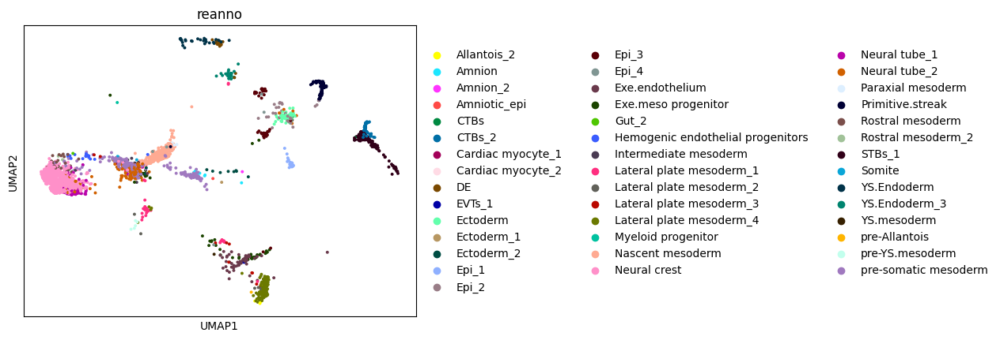

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


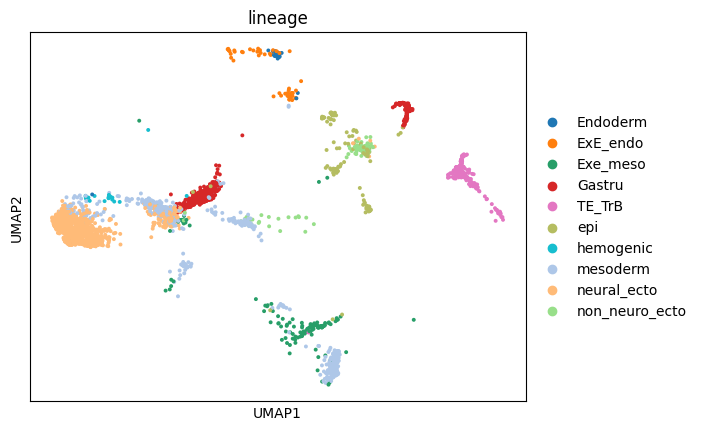

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


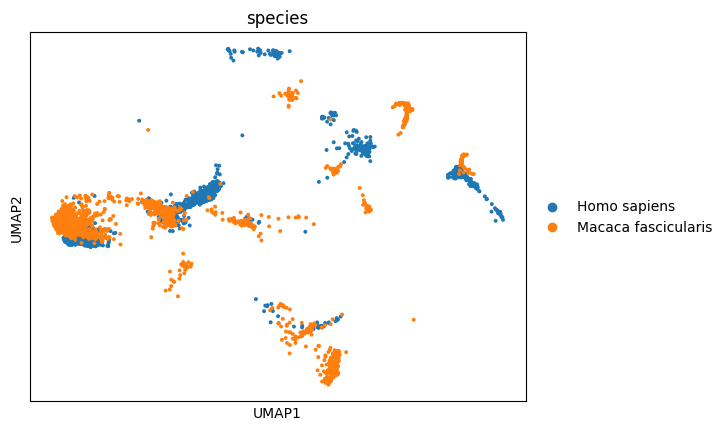

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


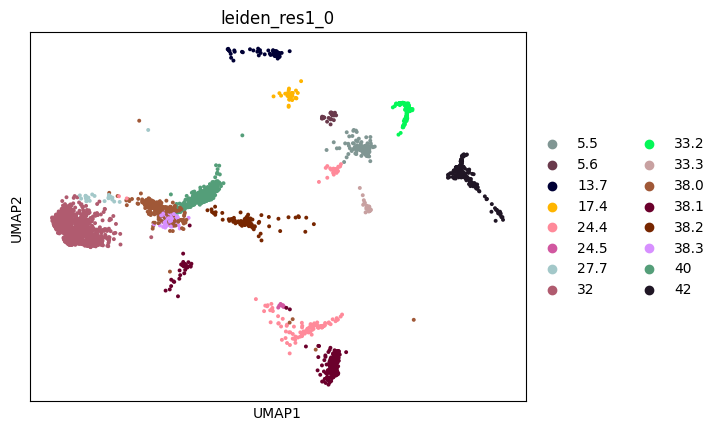

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


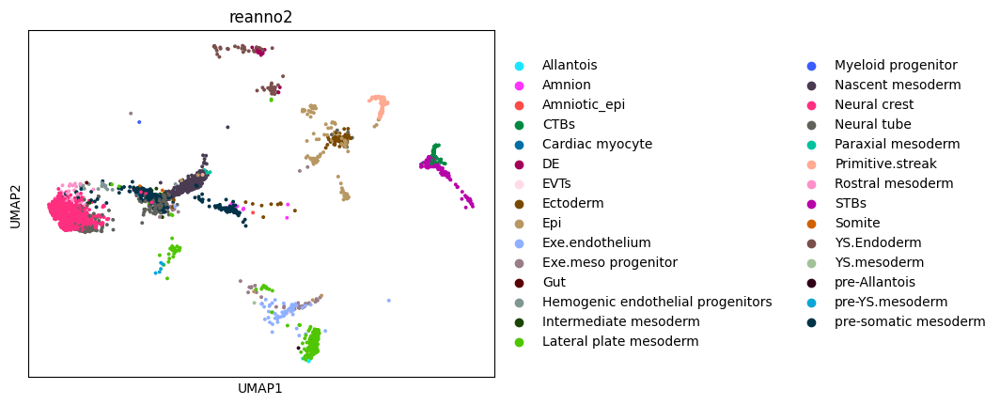

In [82]:
sc.pl.umap(ana_sub, color=['reanno'])
sc.pl.umap(ana_sub, color=['lineage'])
sc.pl.umap(ana_sub, color=['species'])
sc.pl.umap(ana_sub, color=['leiden_res1_0'])
sc.pl.umap(ana_sub, color=['reanno2'])

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


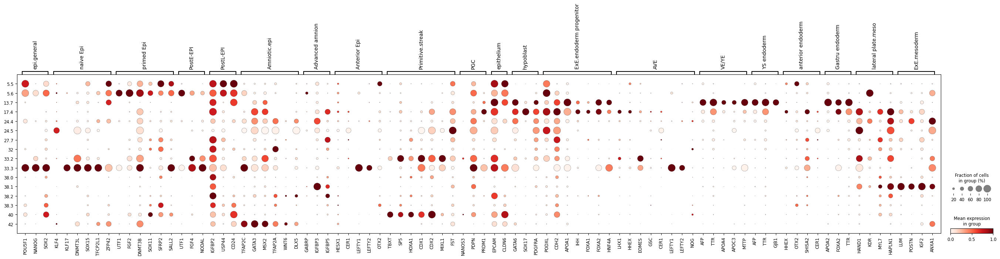

In [83]:
sc.pl.dotplot(ana_sub, epi_marker_genes, groupby="leiden_res1_0", use_raw=False, standard_scale="var")

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


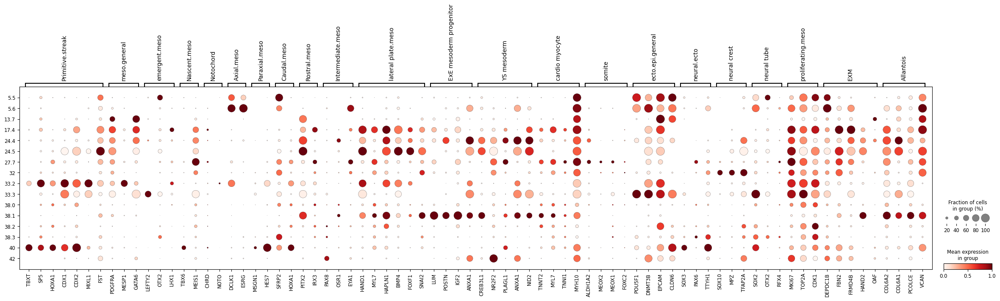

In [84]:
sc.pl.dotplot(ana_sub, meso_marker_genes, groupby="leiden_res1_0", use_raw=False, standard_scale="var")

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


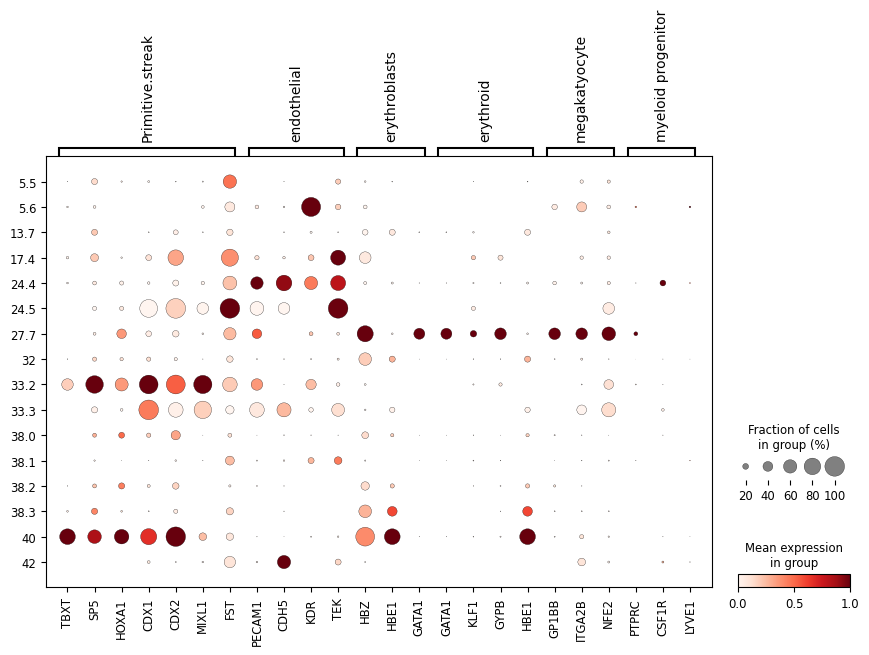

In [85]:
sc.pl.dotplot(ana_sub, hemato_marker_genes, groupby="leiden_res1_0", use_raw=False, standard_scale="var")

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


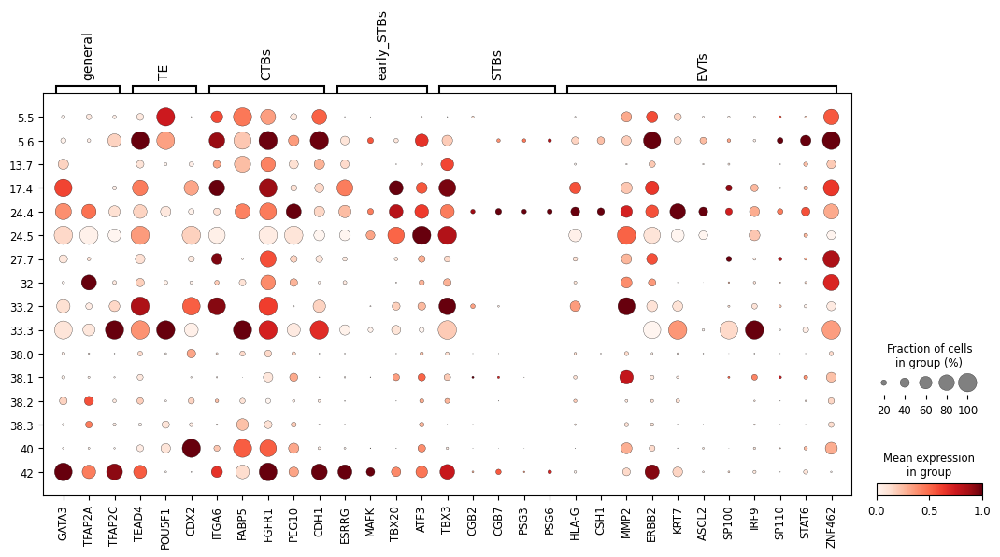

In [86]:
sc.pl.dotplot(ana_sub, TE_marker_genes, groupby="leiden_res1_0", use_raw=False, standard_scale="var")

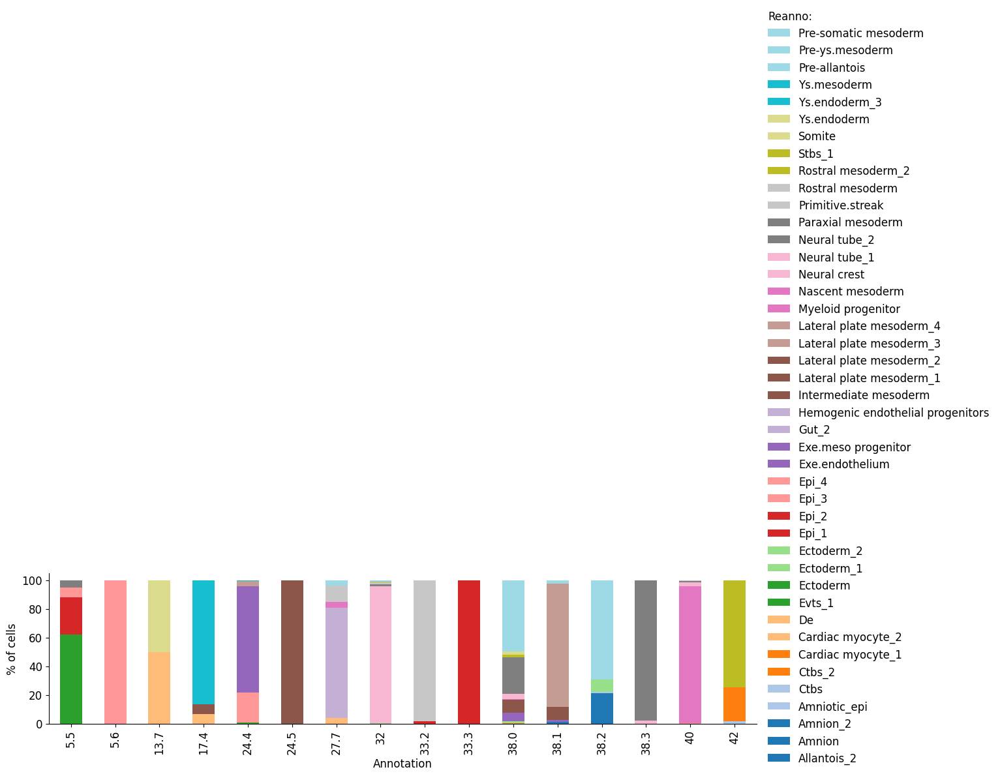

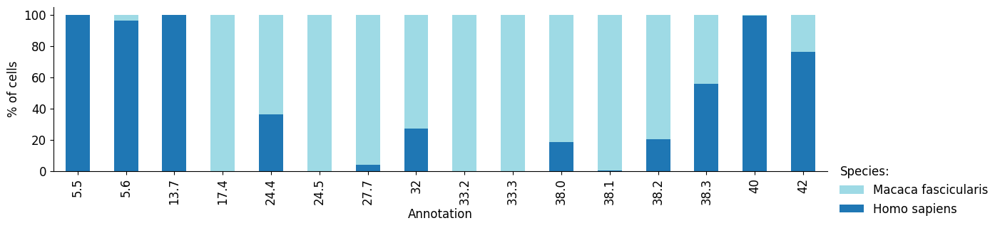

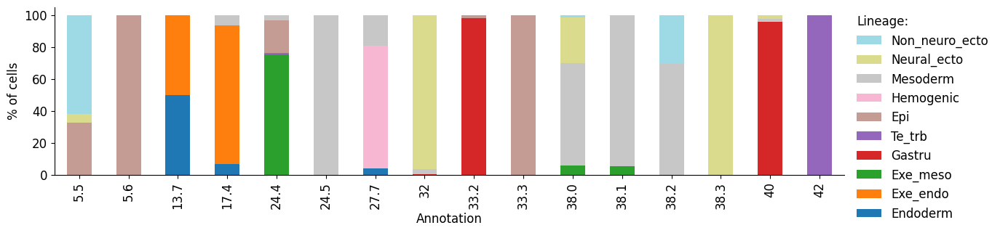

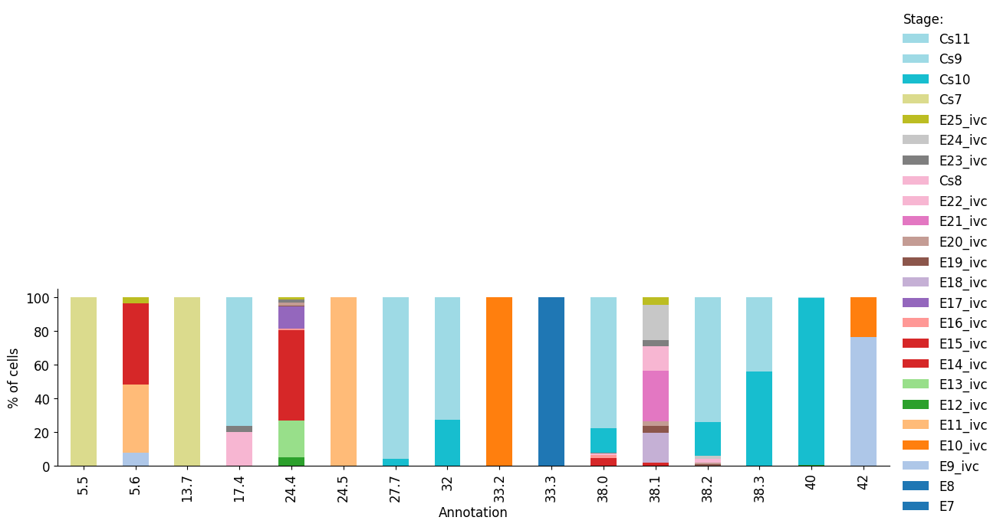

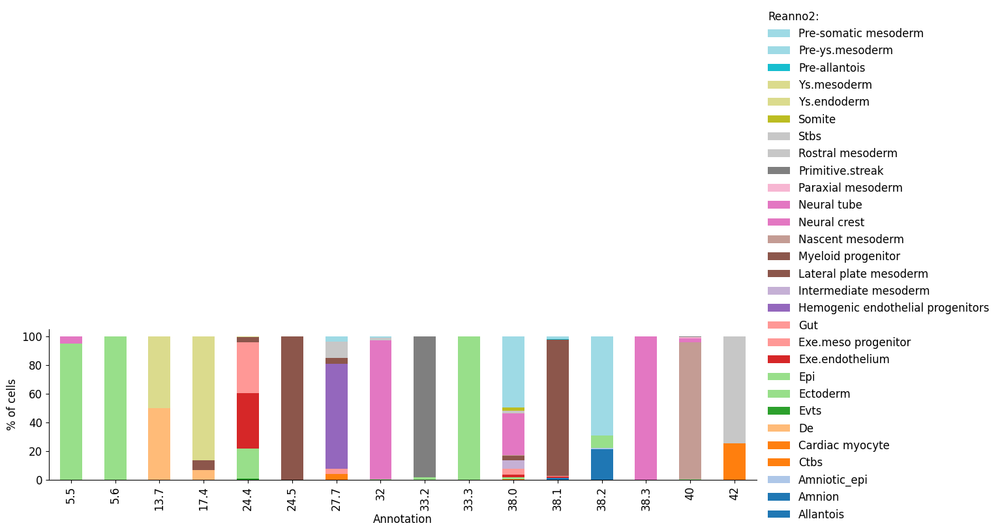

In [87]:
FIGURES = dict()
fz = 12
annos = ['reanno', 'species', 'lineage','stage','reanno2']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['leiden_res1_0'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [88]:
##rename clusters

ana_sub.obs['reanno_3'] = ana_sub.obs['leiden_res1_0'].cat.add_categories(['Epi_3','YS.Endoderm_1','Hemogenic endothelial progenitors',
                                                                          'Neural crest','Primitive streak','Epi_1','Lateral plate mesoderm_1',
                                                                          'Neural tube', 'Nascent mesoderm','pre-somatic mesoderm','STBs_1',
                                                                           'Exe.endothelium','Lateral plate mesoderm_3'])

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '5.5','5.6', ])] = 'Epi_3'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '13.7', ])] = 'YS.Endoderm_1'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '17.4', ])] = 'YS.Endoderm_1'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '24.4', ])] = 'Exe.endothelium'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '24.5', ])] = 'Lateral plate mesoderm_3'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '27.7', ])] = 'Hemogenic endothelial progenitors'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '32', ])] = 'Neural crest'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '33.2', ])] = 'Primitive streak'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '33.3', ])] = 'Epi_1'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '38.1',])] = 'Lateral plate mesoderm_1' 
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '38.3', ])] = 'Neural tube'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '38.0','38.2', ])] = 'pre-somatic mesoderm'

ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '40',])] = 'Nascent mesoderm'
ana_sub.obs['reanno_3'][np.in1d(ana_sub.obs['reanno_3'], [ '42',])] = 'STBs_1'


ana_sub.obs['reanno_3'] = ana_sub.obs['reanno_3'].cat.remove_unused_categories()

In [89]:
# Extract the sub-cluster labels
sub_cluster_labels = ana_sub.obs['reanno_3']

# Combine the categories
combined_categories = pd.CategoricalDtype(categories=list(set(adata.obs['reanno_3'].cat.categories).union(set(sub_cluster_labels.cat.categories))))

# Convert both columns to the combined categories
adata.obs['reanno_3'] = adata.obs['reanno_3'].astype(combined_categories)
sub_cluster_labels = sub_cluster_labels.astype(combined_categories)

# Ensure indices in ann_sub are a subset of those in adata
assert set(ana_sub.obs.index).issubset(set(adata.obs.index)), "Indices in ann_sub are not a subset of those in adata"

# Update 'reanno' in adata with the values from sub_cluster_labels
adata.obs.loc[ana_sub.obs.index, 'reanno_3'] = sub_cluster_labels.loc[ana_sub.obs.index]

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


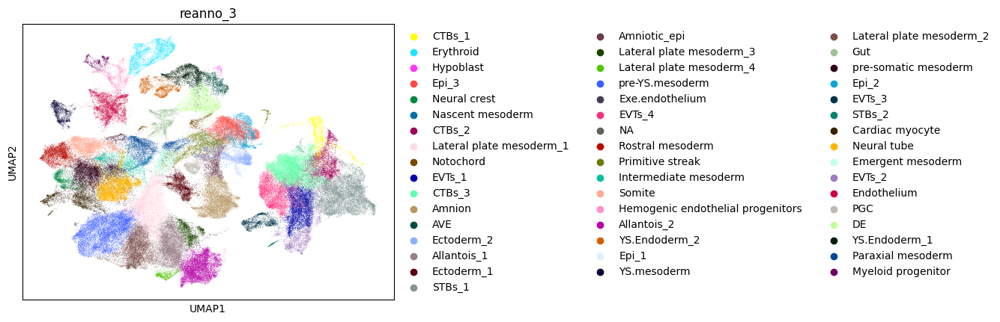

In [90]:
sc.pl.umap(adata, color=['reanno_3'])

In [91]:
# Drop unused categories from the 'reanno' column
adata.obs['reanno_3'] = adata.obs['reanno_3'].cat.remove_unused_categories()

In [92]:
na_rows = adata.obs[adata.obs['reanno_3'] == 'NA']
reanno_na = na_rows['leiden_res1_0']
print(reanno_na)

Series([], Name: leiden_res1_0, dtype: category
Categories (91, object): ['0', '1', '2.0', '2.1', ..., '40', '41', '42', '43'])


/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


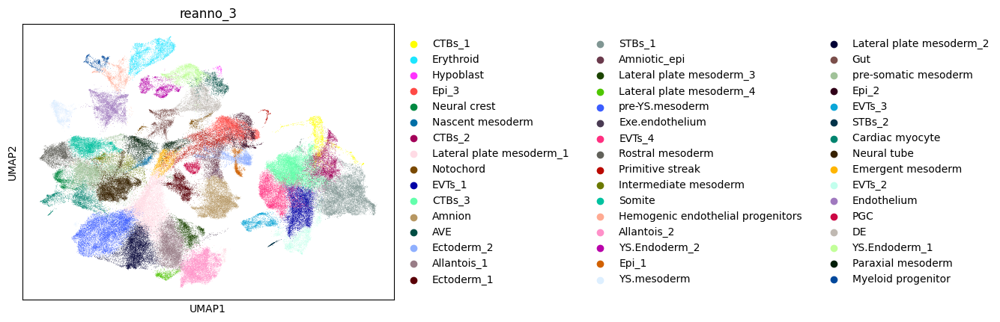

In [93]:
sc.pl.umap(adata, color=['reanno_3'])

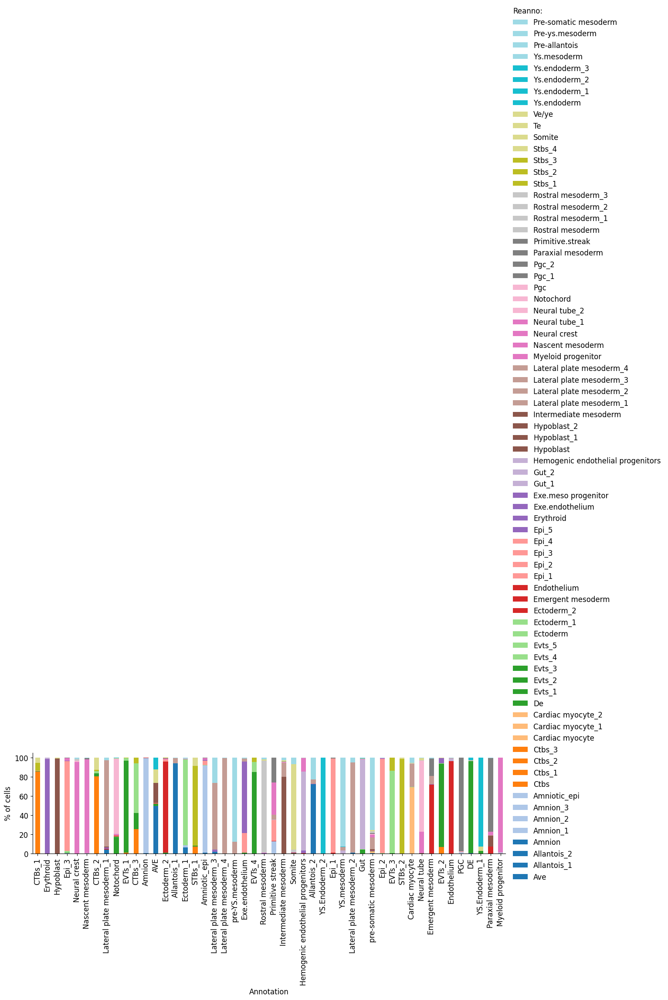

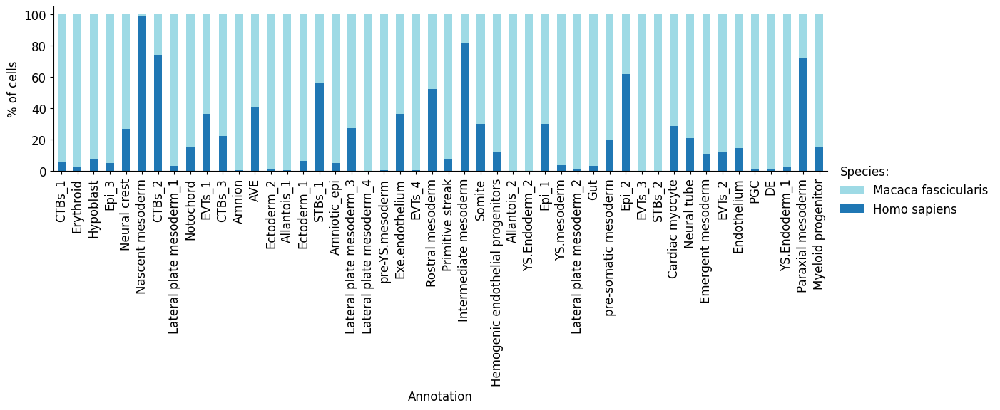

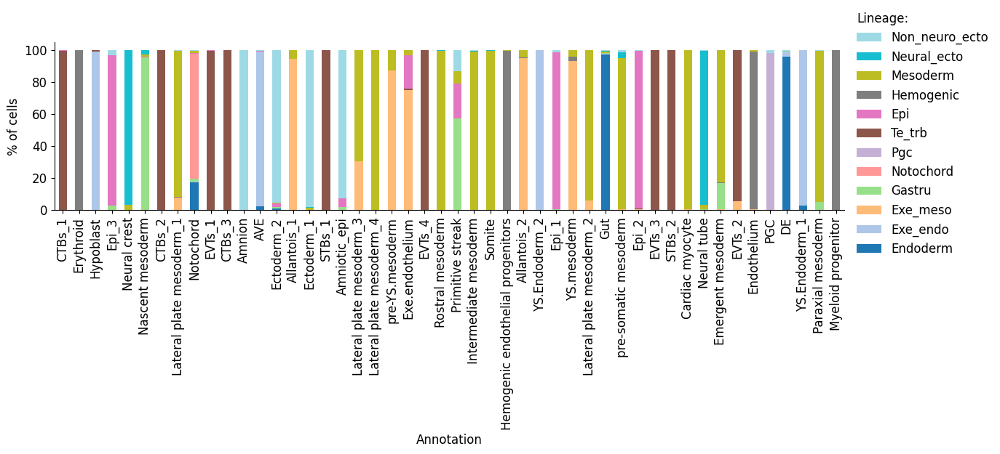

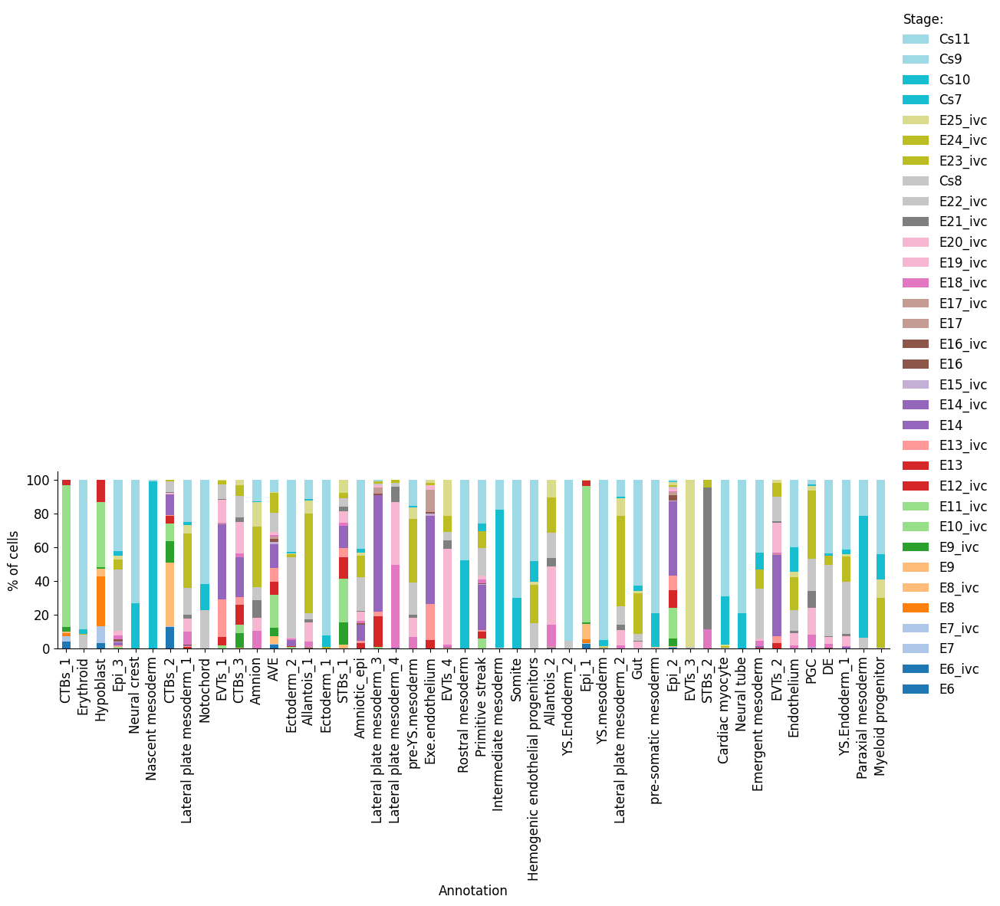

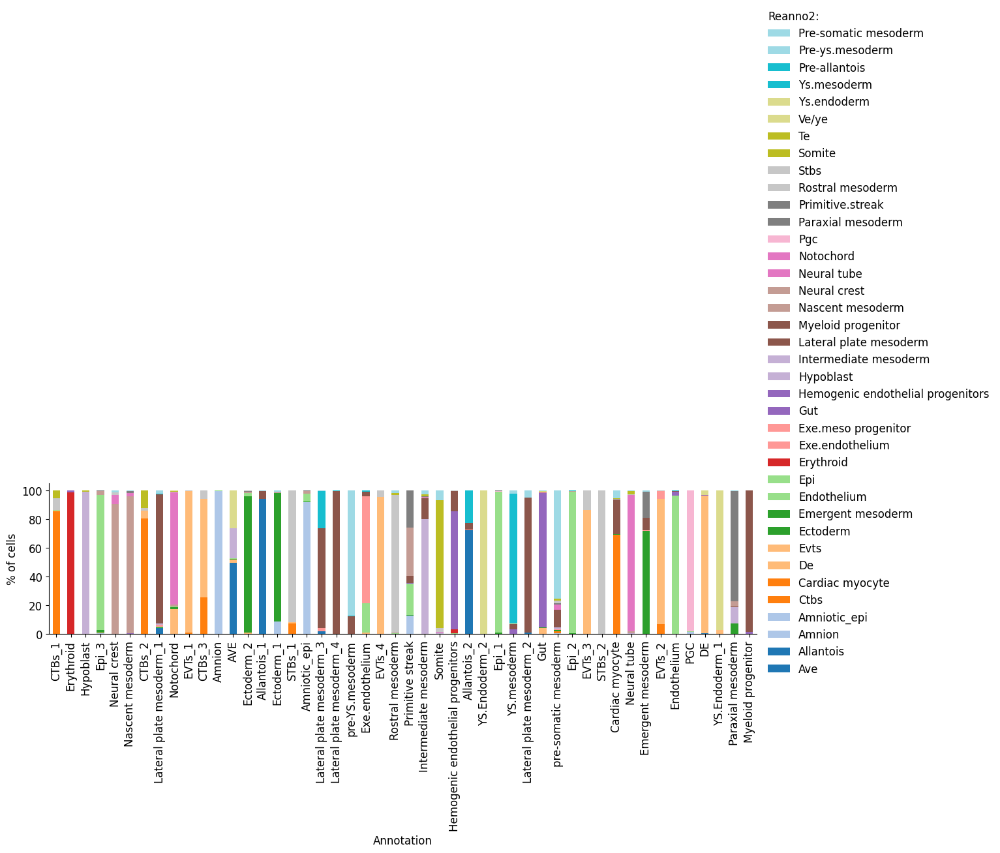

In [94]:
FIGURES = dict()
fz = 12
annos = ['reanno', 'species', 'lineage','stage','reanno2']
for x in annos:
    study_count_per_ct = pd.crosstab(adata.obs['reanno_3'], adata.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [95]:
set(adata.obs['reanno_3'])

{'AVE',
 'Allantois_1',
 'Allantois_2',
 'Amnion',
 'Amniotic_epi',
 'CTBs_1',
 'CTBs_2',
 'CTBs_3',
 'Cardiac myocyte',
 'DE',
 'EVTs_1',
 'EVTs_2',
 'EVTs_3',
 'EVTs_4',
 'Ectoderm_1',
 'Ectoderm_2',
 'Emergent mesoderm',
 'Endothelium',
 'Epi_1',
 'Epi_2',
 'Epi_3',
 'Erythroid',
 'Exe.endothelium',
 'Gut',
 'Hemogenic endothelial progenitors',
 'Hypoblast',
 'Intermediate mesoderm',
 'Lateral plate mesoderm_1',
 'Lateral plate mesoderm_2',
 'Lateral plate mesoderm_3',
 'Lateral plate mesoderm_4',
 'Myeloid progenitor',
 'Nascent mesoderm',
 'Neural crest',
 'Neural tube',
 'Notochord',
 'PGC',
 'Paraxial mesoderm',
 'Primitive streak',
 'Rostral mesoderm',
 'STBs_1',
 'STBs_2',
 'Somite',
 'YS.Endoderm_1',
 'YS.Endoderm_2',
 'YS.mesoderm',
 'pre-YS.mesoderm',
 'pre-somatic mesoderm'}

In [96]:
# Assuming `adata.obs['reanno']` contains your reanno names
reanno_names = set(adata.obs['reanno_3'].unique())  # Get unique reanno names as a set

# reorder "anno" labels
# Reordered labels as per your example
ordered_labels = [
    'CTBs_1', 'CTBs_2', 'CTBs_3', 'STBs_1', 'STBs_2', 
    'EVTs_1', 'EVTs_2', 'EVTs_3', 'EVTs_4',
    'Epi_1', 'Epi_2', 'Epi_3', 'Amniotic_epi', 'Amnion',
    'Primitive streak', 'Ectoderm_1', 'Ectoderm_2', 'PGC', 
    'Hypoblast',  'AVE', 'Gut', 
    'DE', 'Notochord', 'YS.Endoderm_1', 'YS.Endoderm_2', 'Exe.endothelium',                                              
     'Allantois_1', 'Allantois_2', 'pre-YS.mesoderm', 'YS.mesoderm', 
    'Neural tube', 'Neural crest',
    'Nascent mesoderm', 'Emergent mesoderm', 'Paraxial mesoderm', 'Intermediate mesoderm', 'Lateral plate mesoderm_1',
    'Lateral plate mesoderm_2', 'Lateral plate mesoderm_3', 'Lateral plate mesoderm_4',
    'pre-somatic mesoderm', 'Somite', 'Rostral mesoderm',
    'Cardiac myocyte', 'Hemogenic endothelial progenitors', 'Endothelium', 'Erythroid', 'Myeloid progenitor',
]

# Convert `ordered_labels` list to a set
ordered_labels_set = set(ordered_labels)

# Find names in reanno that are not in ordered_labels
missing_in_ordered = reanno_names.difference(ordered_labels_set)

# Output the results
if len(missing_in_ordered) == 0:
    print("All reanno names are listed in ordered_labels.")
else:
    print("These reanno names are missing in ordered_labels:", missing_in_ordered)

All reanno names are listed in ordered_labels.


In [97]:
# reorder "anno" labels
ordered_labels = [ 'CTBs_1', 'CTBs_2', 'CTBs_3', 'STBs_1', 'STBs_2', 
    'EVTs_1', 'EVTs_2', 'EVTs_3', 'EVTs_4',
    'Epi_1', 'Epi_2', 'Epi_3', 'Amniotic_epi', 'Amnion',
    'Primitive streak', 'Ectoderm_1', 'Ectoderm_2', 'PGC', 
    'Hypoblast',  'AVE', 'Gut', 
    'DE', 'Notochord', 'YS.Endoderm_1', 'YS.Endoderm_2', 'Exe.endothelium',                                              
     'Allantois_1', 'Allantois_2', 'pre-YS.mesoderm', 'YS.mesoderm', 
    'Neural tube', 'Neural crest',
    'Nascent mesoderm', 'Emergent mesoderm', 'Paraxial mesoderm', 'Intermediate mesoderm', 'Lateral plate mesoderm_1',
    'Lateral plate mesoderm_2', 'Lateral plate mesoderm_3', 'Lateral plate mesoderm_4',
    'pre-somatic mesoderm', 'Somite', 'Rostral mesoderm',
    'Cardiac myocyte', 'Hemogenic endothelial progenitors', 'Endothelium', 'Erythroid', 'Myeloid progenitor',
  ]

# Ensure the 'reanno' column is of type 'category' with the specified order
adata.obs['reanno'] = pd.Categorical(adata.obs['reanno'], categories=ordered_labels, ordered=True)

# Verify the changes
print(adata.obs['reanno'].cat.categories)


Index(['CTBs_1', 'CTBs_2', 'CTBs_3', 'STBs_1', 'STBs_2', 'EVTs_1', 'EVTs_2',
       'EVTs_3', 'EVTs_4', 'Epi_1', 'Epi_2', 'Epi_3', 'Amniotic_epi', 'Amnion',
       'Primitive streak', 'Ectoderm_1', 'Ectoderm_2', 'PGC', 'Hypoblast',
       'AVE', 'Gut', 'DE', 'Notochord', 'YS.Endoderm_1', 'YS.Endoderm_2',
       'Exe.endothelium', 'Allantois_1', 'Allantois_2', 'pre-YS.mesoderm',
       'YS.mesoderm', 'Neural tube', 'Neural crest', 'Nascent mesoderm',
       'Emergent mesoderm', 'Paraxial mesoderm', 'Intermediate mesoderm',
       'Lateral plate mesoderm_1', 'Lateral plate mesoderm_2',
       'Lateral plate mesoderm_3', 'Lateral plate mesoderm_4',
       'pre-somatic mesoderm', 'Somite', 'Rostral mesoderm', 'Cardiac myocyte',
       'Hemogenic endothelial progenitors', 'Endothelium', 'Erythroid',
       'Myeloid progenitor'],
      dtype='object')


/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


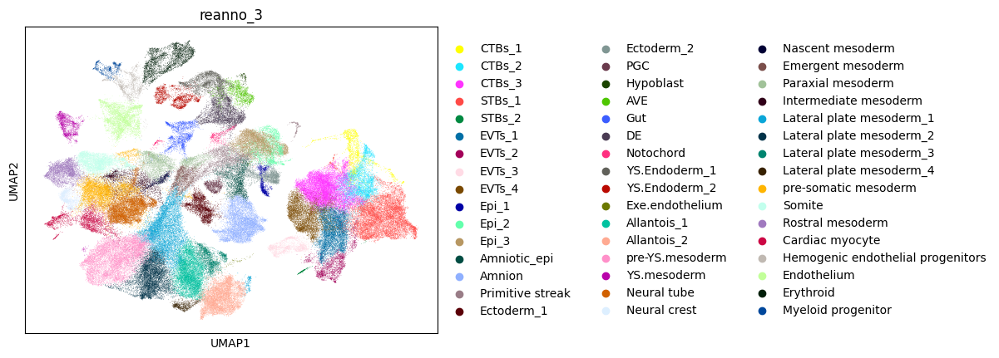

In [98]:
sc.pl.umap(adata, color=['reanno_3'])

In [99]:
#check clusters
print(adata.obs['reanno_3'].value_counts())

CTBs_3                               11440
STBs_1                               10715
pre-YS.mesoderm                       9679
Lateral plate mesoderm_1              8839
Allantois_2                           7483
Allantois_1                           7196
Neural tube                           7162
Amnion                                7124
Lateral plate mesoderm_2              7116
EVTs_1                                6693
pre-somatic mesoderm                  6579
EVTs_4                                5472
Epi_3                                 4937
CTBs_2                                4526
Somite                                4497
Endothelium                           4367
DE                                    3816
Rostral mesoderm                      3524
Paraxial mesoderm                     3454
Erythroid                             3358
Cardiac myocyte                       3247
Ectoderm_1                            2976
Primitive streak                      2911
YS.Endoderm

/home/liuxiaodongLab/fanxueying/miniconda3/envs/benchmarking/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


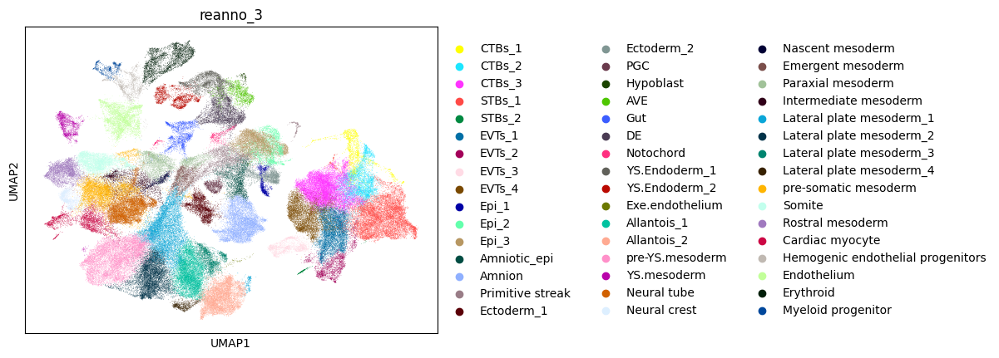

In [100]:
sc.pl.umap(adata, color=['reanno_3'])

In [ ]:
##save dataset
adata.raw.var.rename(columns={'_index': 'index'}, inplace=True)
adata.write_h5ad(filename="human_monkey_reanno.h5ad")